<a href="https://colab.research.google.com/github/Jefferson-Luis/Data-Science-com-Python/blob/main/Data_Science_com_Python_Modulo3.Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Obtenção e Armazenamento de Dados 
### Módulo 3 - Aula 1: Filtro de dados


O Objetivo deste módulo é dar início ao processo de transformação e processamento de dados , para deixar no formato que precisamos antes de realizar a análise. Além disso, mostraremos como filtrar, modificar e juntar diferentes tipos de dados.




# 1.   Bibliotecas


Dando continuidade ao que aprendemos no módulo anterior, neste módulo continuaremos explorando todo o potencial da biblioteca pandas. Esta é a biblioteca de referência que devemos usar quando há necessidade de processamento e tratamento de dados. Além disso, vamos mostrar alguns procedimentos que podemos realizar com dados, utilizando para isso dados financeiros como exemplo.





In [11]:
# Execute apenas se for preciso instalar as bibliotecas

!pip install datetime
!pip install matplotlib plotly
!pip install yfinance quandl

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [12]:
# Manipulação de dados
import pandas as pd
import numpy as np

# Visualização de dados
import matplotlib.pyplot as plt
import plotly.graph_objects as go

# Importação de dados financeiros
import yfinance as yf
import quandl


# 2. Cria e organizar  um datafram

## 2.1 Dataframe simples, uma coluna

Vamos utilizar a API da quandl(Nasdaq) que já vimos anteriormente para fazer a extração dos dados da Selic.

In [13]:
# Aqui você deve inserir sua senha de acesso da API

quandl.ApiConfig.api_key = "GT-6pdjTWZpWiaDuz-ma"

In [14]:
# Os códigos referentes a cada papel / moeda / taxa de juros podem ser obtidos na busca do proprio site da Quandl
# Nesse caso, a selic é representada por BCB/432

quandl.get("BCB/432")

,Value
Date,
1999-03-05,45.00
1999-03-06,45.00
1999-03-07,45.00
1999-03-08,45.00
1999-03-09,45.00
...,...
2022-05-29,12.75
2022-05-30,12.75
2022-05-31,12.75


In [15]:
# Efetuando alguns filtro para facilitar pois temos 8481 linha

selic = quandl.get('BCB/432', start_date = '2000-01-01', end_date = '2022-12-31')

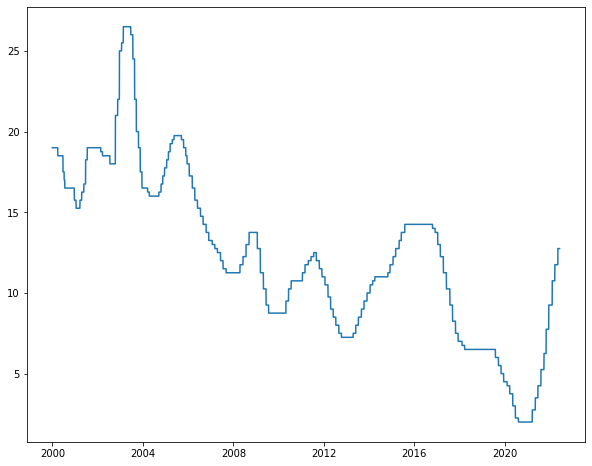

In [16]:
# plt.figure()   padrão 
plt.figure(figsize=(10,8))
plt.plot(selic)
plt.show()

In [17]:
# Inspecionar o formato dos dados

selic.head()

,Value
Date,
2000-01-01,19.0
2000-01-02,19.0
2000-01-03,19.0
2000-01-04,19.0
2000-01-05,19.0


Observe a estrutura do data frame acima. Perceba que ele possui apenas uma coluna e um índice(data). Data Frames assim são fáceis de trabalhar, pois as tarefas realizadas nele são automaticamente aplicadas a sua única coluna, portanto não é necessário mencionar o nome desta única coluna.

Os dataframes lembram muito os nossos conhecidos arquivos de planilha como Excel ou Google Sheets

## 2.2. Filtros simples

Imagine que você trabalha num banco e agora lhe foi dada a tarefa de selecionar um valor de Selic para um dia específico. Como você poderia fazer?
 

---


É para resolver problemas assim que existem os métodos .loc e .iloc. Como eles funcionam?


---


 A ideia desses métodos é de possibilitar um filtro no nosso dados para obter uma linha de célula específicas.

O método .loc

O .loc é utilizado quando o filtro deve ser feito com a métrica utilizada no índice do nosso dataframe.
Por exemplo, a métrica utilizada como índice no nosso dataframe é data. Portanto, nesse caso devemos usar o .loc com a data que queremos fazer o filtro.
Imagine que o seu gestor te perguntou qual era o valor da Selic no dia 26/05/21.

Você poderia ter feito assim:

In [18]:
selic_filtrada = selic.loc['2021-5-26']

In [19]:
selic_filtrada

Value    3.5
Name: 2021-05-26 00:00:00, dtype: float64

In [20]:
# Para obter os dados entre duas datas específicas

selic_filtrada = selic.loc['2019-03-26':'2021-05-26']
selic_filtrada

,Value
Date,
2019-03-26,6.5
2019-03-27,6.5
2019-03-28,6.5
2019-03-29,6.5
2019-03-30,6.5
...,...
2021-05-22,3.5
2021-05-23,3.5
2021-05-24,3.5


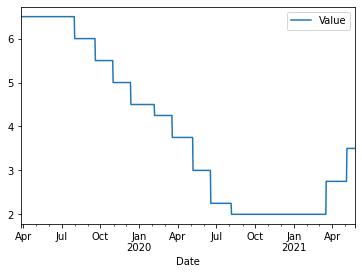

In [21]:
selic_filtrada.plot()

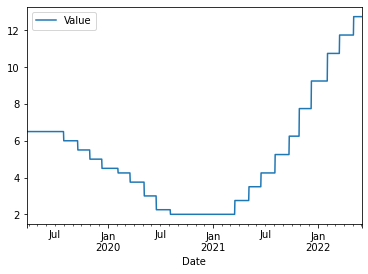

In [22]:
# Filtrando a partir de uma data específica e indo até o último dia disponível

selic_filtrada = selic.loc['2019-03-26':]
selic_filtrada.plot()

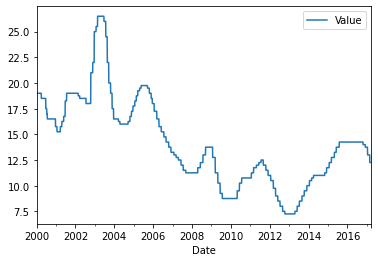

In [23]:
# Obtendo os dados desde o início e indo até uma data limite específica, nesse caso 26/03/2017

selic_filtrada = selic.loc [:'2017-03-26']
selic_filtrada.plot()

O método .iloc

O .iloc é utilizado quando o filtro deve ser feito com a posição da linha dentro do nosso dataframe.

Por exemplo, caso você precise da linha 0 ou linha 1. Ou mesmo se precisar da linha 200 até a linha 500. 

Exemplos:

In [24]:
# Obtendo a linha 0 ( primeira linha, excluíndo o cabeçalho)

selic_filtrada = selic.iloc[0]
selic_filtrada

Value    19.0
Name: 2000-01-01 00:00:00, dtype: float64

In [25]:
# Obtendo a linha 1 (lembrar sempre da indexação inciando com 0 em  Python)

selic_filtrada = selic.iloc[1]
selic_filtrada

Value    19.0
Name: 2000-01-02 00:00:00, dtype: float64

In [26]:
# Obtendo a linha 200

selic_filtrada = selic.iloc[200]
selic_filtrada

Value    17.0
Name: 2000-07-19 00:00:00, dtype: float64

In [27]:
# Obtendo a última linha

selic_filtrada = selic.iloc[-1]
selic_filtrada

Value    12.75
Name: 2022-06-02 00:00:00, dtype: float64

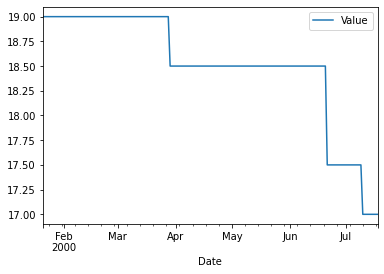

In [28]:
# Obtendo da linha 20 até a linha 200 ( lembrando também da indexação, 200 não inclusiva)

selic_filtrada = selic.iloc[20:200]
selic_filtrada.plot()

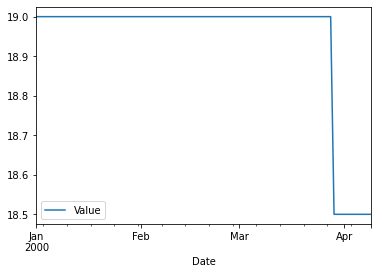

In [29]:
# Obtendo todas as linhas até a linha 100 ( linha 100 não entra)

selic_filtrada = selic.iloc[:100]
selic_filtrada.plot()

## 2.3. Noções importantes de dataframes

Para demonstrar manipulações de dados em um dataframes de várias colunas, vamos extrair os dados das ações que compôem o IBOV

Para saber a composição atualizada do IBOV, acesse o link:https://www.b3.com.br/pt_br/market-data-e-indices/indices/indices-amplos/indice-ibovespa-ibovespa-composicao-da-carteira.htm

Nesta seção, vamos utilizar algumas bibliotecas de dados de mercado financeiro, como a yfinance, que extrai dados do Yahoo Finance

Os ativos que compôem o IBOV são os seguintes:
['WEGE3','EMBR3','AZUL4','CCRO3','ECOR3','GOLL4','RAIL3','POSI3','BRFS3','JBSS3','MRFG3','BEEF3','ABEV3','ASAI3','CRFB3','PCAR3',
 'NTCO3','AMER3','SOMA30','LREN3','MGLU3','PETZ3','VIIA3','ALPA4','CYRE3','EZTC3','JHSF3','MRVE3','CVCB3','COFN3','RENT3','LCAM3',
 'YDYQ3','BRML3','IGTI11','MULT3','DIBI11','BPAN4','BBDC3','BBDC4','BPAC11','ITSA4','ITUB4','SANB11','BBSE3','IRBR3','SULA11',
 'PETR4','PRIO3','UGPA3','VBBR3','HYPE3','RADL3','FLRY3','HAPV3','GNDI3','QUAL3','RDOR3','LWSA3','CASH3','TOTS3','VIVT3','TIMS3',
 'SBSP3','CMIG4','CPLE6','CPFE3','ELET3','ELET6','ENBR3','ENGI11','ENEV3','EGIE3','EQTL3','TAEE11']

Vamos transformar isso agora numa lista

In [30]:
tickers_IBOV = ['ABCB4','BBAS3','BBDC4','BPAN4','BTOW3','CGAS3','CMIG4','CSNA3','CYRE3','ELET3','ELPL4','ENBR3','EQTL3','EZTC3','FIBR3','GOAU4','HGTX3','ITUB4','LAME4','LREN3','MRVE3','MYPK3','PETR4','POMO4','QGEP3','RAPT4','SAPR4','SBSP3','SUZB5','TUPY3','USIM5','VALE5','WEGE3']

In [31]:
# Como ordenar esses papéis em ordem alfabética?

tickers_IBOV.sort()
tickers_IBOV

['ABCB4',
 'BBAS3',
 'BBDC4',
 'BPAN4',
 'BTOW3',
 'CGAS3',
 'CMIG4',
 'CSNA3',
 'CYRE3',
 'ELET3',
 'ELPL4',
 'ENBR3',
 'EQTL3',
 'EZTC3',
 'FIBR3',
 'GOAU4',
 'HGTX3',
 'ITUB4',
 'LAME4',
 'LREN3',
 'MRVE3',
 'MYPK3',
 'PETR4',
 'POMO4',
 'QGEP3',
 'RAPT4',
 'SAPR4',
 'SBSP3',
 'SUZB5',
 'TUPY3',
 'USIM5',
 'VALE5',
 'WEGE3']

** PONTO IMPORTANTE **

As ações brasileiras no Yahoo Finance terminam com ".SA". Isso é válido inclusive para outros papéis, como ETFs, FIIs, BDRs


Como acrescentar ".SA" ao fim do nome de um papel?

Veja o raciocínio abaixo:

In [32]:
acao = 'PETR4'

acao + '.SA'

# Observe que "somamos" o ".SA" ao ticker de "PETR4"


'PETR4.SA'

Precisamos então criar uma estrutura que faça isso para todos os papéis de uma vez

In [33]:
ativo_SA = 0
tickers_IBOV_SA = []

for i in tickers_IBOV: 
  ativo_SA = (i +'.SA')
  tickers_IBOV_SA.append(ativo_SA)

tickers_IBOV_SA

['ABCB4.SA',
 'BBAS3.SA',
 'BBDC4.SA',
 'BPAN4.SA',
 'BTOW3.SA',
 'CGAS3.SA',
 'CMIG4.SA',
 'CSNA3.SA',
 'CYRE3.SA',
 'ELET3.SA',
 'ELPL4.SA',
 'ENBR3.SA',
 'EQTL3.SA',
 'EZTC3.SA',
 'FIBR3.SA',
 'GOAU4.SA',
 'HGTX3.SA',
 'ITUB4.SA',
 'LAME4.SA',
 'LREN3.SA',
 'MRVE3.SA',
 'MYPK3.SA',
 'PETR4.SA',
 'POMO4.SA',
 'QGEP3.SA',
 'RAPT4.SA',
 'SAPR4.SA',
 'SBSP3.SA',
 'SUZB5.SA',
 'TUPY3.SA',
 'USIM5.SA',
 'VALE5.SA',
 'WEGE3.SA']

Uma vez que temos uma lista com o nome dos tickers corrigidos para fazer a busca na yfinance (que extrai os dados Yahoo Finance)

In [34]:
# Extração para um ativo 

yf.download('PETR4.SA', start = '2022-02-01', end='2022-02-18', period ='1d')


[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2022-02-01,32.349998,33.320000,31.950001,33.000000,27.068611,57315200
2022-02-02,33.410000,33.490002,32.360001,32.520000,26.674887,36271700
2022-02-03,32.349998,32.919998,31.620001,32.070000,26.305767,51087800
2022-02-04,32.410000,33.230000,31.879999,32.630001,26.765116,59346800
2022-02-07,32.549999,32.779999,32.130001,32.150002,26.371389,48868100
2022-02-08,31.900000,31.950001,31.260000,31.830000,26.108906,62590000
2022-02-09,31.740000,32.689999,31.650000,31.950001,26.207338,50960500
2022-02-10,32.299999,32.900002,31.940001,32.439999,26.609264,49534600
2022-02-11,32.770000,33.910000,32.630001,33.759998,27.692007,88013400


Observe a estrutura dos dados acima. Temos Abertura, Máxima, Mínima, Fechamento, Fechamento Ajustado e Volume. Podemos reproduzir a mesma estrutura caso queiramos obter dados de vários papéis ao mesmo tempo.

In [35]:
# Na yfinance as vezes pode ocorrer erros na busca de alguns ativos (usualmente se for uma unit). Note que nesse caso houve um erro em BIDI11
# Pode ver que é um problema pontual https://finance.yahoo.com/quote/BIDI11.SA/history?p=BIDI11.SA


yf.download(tickers_IBOV_SA, start = '2022-02-01', end='2022-02-18', period ='1d')

[*********************100%***********************]  33 of 33 completed

8 Failed downloads:
- HGTX3.SA: No data found, symbol may be delisted
- BTOW3.SA: No data found, symbol may be delisted
- QGEP3.SA: No data found, symbol may be delisted
- VALE5.SA: No data found for this date range, symbol may be delisted
- SUZB5.SA: No data found for this date range, symbol may be delisted
- LAME4.SA: No data found, symbol may be delisted
- ELPL4.SA: No data found for this date range, symbol may be delisted
- FIBR3.SA: No data found for this date range, symbol may be delisted


Adj Close                                                        \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                          
2022-02-01  15.915528  31.519228  20.684198  10.326815      NaN  135.359589   
2022-02-02  15.935165  30.997290  20.312309   9.569250      NaN  130.383133   
2022-02-03  15.925346  31.209932  20.610886   9.190467      NaN  129.387848   
2022-02-04  15.846800  31.151939  20.746601   9.180499      NaN  129.387848   
2022-02-07  15.846800  30.794315  20.674219   9.240307      NaN  129.387848   
2022-02-08  15.954803  31.122944  20.556601   9.967968      NaN  129.387848   
2022-02-09  15.512978  30.852308  18.792280   9.967968      NaN  129.387848   
2022-02-10  15.719163  31.190599  19.063711   9.918128      NaN  129.387848   
2022-02-11  16.210079  32.282803  19.127047   9.918128      NaN  123.416100   
2022-02-14  16.200260  32.418121  19.154190   9.997872      NaN  123.416100   
2022-02-15  16.642086  33.954941  19.172285  11.044509      NaN  123.416100   
2022-02-16  16.612631  34.148251  19.398481  11.094349      NaN  124.510918   
2022-02-17  16.386810  34.148251  19.172285  11.253837      NaN  124.510918   

                                                       ...   Volume           \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ... POMO4.SA QGEP3.SA   
Date                                                   ...                     
2022-02-01  9.267417  26.396038  16.578217  33.983326  ...  6511800      NaN   
2022-02-02  9.106668  26.523935  16.183725  33.256935  ...  6341600      NaN   
2022-02-03  9.169570  26.081215  16.183725  33.708477  ...  3568300      NaN   
2022-02-04  8.952910  26.199272  15.375502  33.070427  ...  5685300      NaN   
2022-02-07  8.771197  27.025686  15.279285  32.844658  ...  6217900      NaN   
2022-02-08  8.827107  27.389702  15.269664  32.540359  ...  3453900      NaN   
2022-02-09  8.931943  27.724203  15.250421  33.364914  ...  3541000      NaN   
2022-02-10  8.994844  27.753717  15.173447  33.364914  ...  4230200      NaN   
2022-02-11  8.917966  27.360188  15.260041  32.717052  ...  6280500      NaN   
2022-02-14  8.827107  27.291319  15.317772  32.805393  ...  2522200      NaN   
2022-02-15  9.001834  25.972994  15.972049  34.847141  ...  2835000      NaN   
2022-02-16  9.183548  26.081215  16.010534  34.523209  ...  2579800      NaN   
2022-02-17  9.064735  24.556284  15.606423  34.533028  ...  4627100      NaN   

                                                                            \
           RAPT4.SA SAPR4.SA SBSP3.SA SUZB5.SA TUPY3.SA  USIM5.SA VALE5.SA   
Date                                                                         
2022-02-01  3770400  2395200  2548400      NaN   587600  22618500      NaN   
2022-02-02  3269200  3504100  2232300      NaN   552300  13505200      NaN   
2022-02-03  2567800  2336300  2632700      NaN   907100  20575800      NaN   
2022-02-04  2281900  2113100  1861800      NaN   611700  14148800      NaN   
2022-02-07  1878700  2412700  1242300      NaN   838200  21626800      NaN   
2022-02-08  1081600  2120400  1433900      NaN   510600  14037400      NaN   
2022-02-09  1776100  1880500  1976900      NaN   423900  14784800      NaN   
2022-02-10  1605300  1717700  1353100      NaN   851400  25220700      NaN   
2022-02-11  2563000  4382600  2420100      NaN  1090700  66203500      NaN   
2022-02-14  1526200  2064900  2170800      NaN   317200  23686600      NaN   
2022-02-15  1796800  1641500  1548800      NaN   374200  28728900      NaN   
2022-02-16  2243400  2166600  1986200      NaN   744200  20383200      NaN   
2022-02-17  2103100  1317000  3942000      NaN   502600  29080100      NaN   

                      
            WEGE3.SA  
Date                  
2022-02-01   4459400  
2022-02-02   4925100  
2022-02-03   5506300  
2022-02-04   5170800  
2022-02-07   5010100  
2022-02-08   6430500  
2022-02-09

Perceba que a estrutura acima replica as 5 colunas(Abertura, Máxima, Mínima, Fechamento, Fechamento Ajustado e Volume )para todos OS
papéis. Isso cria uma estrutura muito grande e difícil de trabalhar. É melhor selecionar apenas uma coluna específica para esses papéis:

In [36]:
# Nesse caso, estamos não apenas extraindo os dados, mas armazenando na variável cotacoes_IBOV

cotacoes_IBOV = yf.download(tickers_IBOV_SA, start='2022-02-10', end='2022-02-18', period = '1d')


[*********************100%***********************]  33 of 33 completed

8 Failed downloads:
- HGTX3.SA: No data found, symbol may be delisted
- BTOW3.SA: No data found, symbol may be delisted
- QGEP3.SA: No data found, symbol may be delisted
- VALE5.SA: No data found for this date range, symbol may be delisted
- SUZB5.SA: No data found for this date range, symbol may be delisted
- LAME4.SA: No data found, symbol may be delisted
- ELPL4.SA: No data found for this date range, symbol may be delisted
- FIBR3.SA: No data found for this date range, symbol may be delisted


Para facilitar nossa vida, podemos obter apenas os dados da coluna Adj Close para todos os papéis de uma vez

In [37]:
yf.download(tickers_IBOV_SA, start='2022-02-10', end='2022-02-18', period = '1d')['Adj Close']

[*********************100%***********************]  33 of 33 completed

8 Failed downloads:
- HGTX3.SA: No data found, symbol may be delisted
- BTOW3.SA: No data found, symbol may be delisted
- QGEP3.SA: No data found, symbol may be delisted
- SUZB5.SA: No data found for this date range, symbol may be delisted
- VALE5.SA: No data found for this date range, symbol may be delisted
- LAME4.SA: No data found, symbol may be delisted
- ELPL4.SA: No data found for this date range, symbol may be delisted
- FIBR3.SA: No data found for this date range, symbol may be delisted


,ABCB4.SA,BBAS3.SA,BBDC4.SA,BPAN4.SA,BTOW3.SA,CGAS3.SA,CMIG4.SA,CSNA3.SA,CYRE3.SA,ELET3.SA,...,POMO4.SA,QGEP3.SA,RAPT4.SA,SAPR4.SA,SBSP3.SA,SUZB5.SA,TUPY3.SA,USIM5.SA,VALE5.SA,WEGE3.SA
Date,,,,,,,,,,,,,,,,,,,,,
2022-02-10,15.719163,31.190599,19.063711,9.918128,NaN,129.387848,8.994844,27.753717,15.173447,33.364914,...,3.01,NaN,10.965174,3.958247,35.247421,NaN,19.850000,15.920329,NaN,29.502254
2022-02-11,16.210079,32.282806,19.127048,9.918128,NaN,123.416100,8.917966,27.360188,15.260041,32.717052,...,2.92,NaN,10.742775,3.968217,35.315994,NaN,19.219999,14.734368,NaN,29.293934
2022-02-14,16.200260,32.418121,19.154190,9.997872,NaN,123.416100,8.827107,27.291319,15.317772,32.805393,...,2.97,NaN,10.868478,3.898424,34.708622,NaN,19.290001,14.876684,NaN,30.196661
2022-02-15,16.642086,33.954937,19.172285,11.044509,NaN,123.416100,9.001834,25.972994,15.972049,34.847141,...,3.04,NaN,11.119884,3.958247,35.688259,NaN,19.610001,14.791294,NaN,32.617157
2022-02-16,16.612631,34.148251,19.398479,11.094349,NaN,124.510918,9.183548,26.081215,16.010534,34.523209,...,3.05,NaN,11.081206,3.958247,36.070320,NaN,19.360001,14.696417,NaN,31.049784
2022-02-17,16.386810,34.148251,19.172285,11.253837,NaN,124.510918,9.064735,24.556284,15.606423,34.533028,...,2.94,NaN,10.704097,3.938306,36.677692,NaN,19.150000,14.098693,NaN,30.404980


Perceba que reduzimos o número de colunas de 552 para 92 ( Adj Close dos 92 ativos da lita
                                                          )

Vamos criar um novo dartaframe com o resultado da busca de cotação ao longo de todo o período de 2021, considerando todos as colunas disponíveis (OHLC,Adj Close e Volume)

In [38]:
cotacoes_IBOV = yf.download(tickers_IBOV_SA, start='2021-01-01', end='2021-12-31', period ="1d")
cotacoes_IBOV

[*********************100%***********************]  33 of 33 completed

8 Failed downloads:
- HGTX3.SA: No data found, symbol may be delisted
- BTOW3.SA: No data found, symbol may be delisted
- QGEP3.SA: No data found, symbol may be delisted
- VALE5.SA: No data found for this date range, symbol may be delisted
- SUZB5.SA: No data found for this date range, symbol may be delisted
- LAME4.SA: No data found, symbol may be delisted
- ELPL4.SA: No data found for this date range, symbol may be delisted
- FIBR3.SA: No data found for this date range, symbol may be delisted


Adj Close                                                        \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                          
2021-01-04  14.575881  33.724125  20.752106   9.127254      NaN  151.589432   
2021-01-05  14.368940  33.374233  20.625578   9.088247      NaN  151.654083   
2021-01-06  14.530895  34.136818  21.309166   9.068747      NaN  151.654083   
2021-01-07  15.016090  35.491516  21.874895   9.146757      NaN  151.654083   
2021-01-08  14.997596  35.697861  21.686317   9.332032      NaN  156.983231   
...               ...        ...        ...        ...      ...         ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247      NaN  134.364304   
2021-12-27  15.430908  28.300615  17.575462  10.466367      NaN  138.335510   
2021-12-28  15.595168  28.136301  17.512241  10.496270      NaN  139.340759   
2021-12-29  15.295633  27.991316  17.430958  10.546110      NaN  148.278473   
2021-12-30  15.334284  27.884996  17.349674  10.645791      NaN  148.278473   

                                                       ...      Volume  \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ...    POMO4.SA   
Date                                                   ...               
2021-01-04  8.125487  32.015358  26.252213  32.503197  ...   6038000.0   
2021-01-05  8.125487  32.596268  25.745594  31.663933  ...   5522900.0   
2021-01-06  8.292133  33.973572  25.082376  31.153080  ...   6941500.0   
2021-01-07  8.200191  36.100433  25.238970  30.934143  ...   5788800.0   
2021-01-08  8.763343  36.315929  26.445650  31.910238  ...  19457700.0   
...              ...        ...        ...        ...  ...         ...   
2021-12-23  9.141614  24.058908  14.538413  32.638519  ...   5473700.0   
2021-12-27  9.197526  24.322433  14.788578  32.618889  ...   2832400.0   
2021-12-28  9.232471  24.351715  14.798200  32.785763  ...   2795700.0   
2021-12-29  9.113658  24.439556  14.827065  32.393120  ...   4142100.0   
2021-12-30  9.162581  24.390755  15.183068  32.795578  ...   5386200.0   

                                                                           \
           QGEP3.SA   RAPT4.SA    SAPR4.SA   SBSP3.SA SUZB5.SA   TUPY3.SA   
Date                                                                        
2021-01-04      NaN  5359600.0   8044700.0  5274100.0      NaN  1828900.0   
2021-01-05      NaN  2517600.0  10266800.0  4327600.0      NaN  2884200.0   
2021-01-06      NaN  3757700.0   7426500.0  5286800.0      NaN  1970700.0   
2021-01-07      NaN  3642200.0   8106000.0  4030500.0      NaN   983800.0   
2021-01-08      NaN  3434500.0   6915700.0  6990900.0      NaN  1648600.0   
...             ...        ...         ...        ...      ...        ...   
2021-12-23      NaN  2442200.0   1669000.0  2098900.0      NaN   260700.0   
2021-12-27      NaN  2096100.0   1918100.0  1891600.0      NaN   244700.0   
2021-12-28      NaN  1844800.0   1860200.0   735000.0      NaN   427600.0   
2021-12-29      NaN  1588600.0   2067100.0  1217400.0      NaN   365200.0   
2021-12-30      NaN  3155100.0   6216100.0  2020000.0      NaN   646300.0   

                                             
              USIM5.SA VALE5.SA    WEGE3.SA  
Date                                         
2021-01-04  20687900.0      NaN   7219800.0  
2021-01-05  18302900.0      NaN  16633600.0  
2021-01-06  23592900.0      NaN  21507400.0  
2021-01-07  22298600.0      NaN  15129600.0  
2021-01-08  23237000.0      NaN  17381000.0  
...                ...      ...         ...  
2021-12-23  10681800.0      NaN   2166400.0  
2021-12-27  10504500.0      NaN   4457200.0  
2021-12-28  13201600.0      NaN   3670800.0  
2021-12-29  10525500.0      NaN   3091700.0  
2021-12-30  12815100.0      NaN   4858300.0  

[248 rows x 198 columns]

In [39]:
# Reforçando a complexidade do dataframe, composto por pois índices de colunas
# Indice 0 para os parâmetros das cotações e índice 1 para os ativos

cotacoes_IBOV.columns

MultiIndex([('Adj Close', 'ABCB4.SA'),
            ('Adj Close', 'BBAS3.SA'),
            ('Adj Close', 'BBDC4.SA'),
            ('Adj Close', 'BPAN4.SA'),
            ('Adj Close', 'BTOW3.SA'),
            ('Adj Close', 'CGAS3.SA'),
            ('Adj Close', 'CMIG4.SA'),
            ('Adj Close', 'CSNA3.SA'),
            ('Adj Close', 'CYRE3.SA'),
            ('Adj Close', 'ELET3.SA'),
            ...
            (   'Volume', 'POMO4.SA'),
            (   'Volume', 'QGEP3.SA'),
            (   'Volume', 'RAPT4.SA'),
            (   'Volume', 'SAPR4.SA'),
            (   'Volume', 'SBSP3.SA'),
            (   'Volume', 'SUZB5.SA'),
            (   'Volume', 'TUPY3.SA'),
            (   'Volume', 'USIM5.SA'),
            (   'Volume', 'VALE5.SA'),
            (   'Volume', 'WEGE3.SA')],
           length=198)

In [40]:
# Usando o set ( conjunto ) podemos remover as duplicatas e ver a lista de parâmetros disponíveis

set(cotacoes_IBOV.columns.get_level_values(0))

{'Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'}

In [41]:
cotacoes_IBOV.head()

Adj Close                                                       \
             ABCB4.SA   BBAS3.SA   BBDC4.SA  BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                         
2021-01-04  14.575881  33.724125  20.752106  9.127254      NaN  151.589432   
2021-01-05  14.368940  33.374233  20.625578  9.088247      NaN  151.654083   
2021-01-06  14.530895  34.136818  21.309166  9.068747      NaN  151.654083   
2021-01-07  15.016090  35.491516  21.874895  9.146757      NaN  151.654083   
2021-01-08  14.997596  35.697861  21.686317  9.332032      NaN  156.983231   

                                                       ...      Volume  \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ...    POMO4.SA   
Date                                                   ...               
2021-01-04  8.125487  32.015358  26.252213  32.503197  ...   6038000.0   
2021-01-05  8.125487  32.596268  25.745594  31.663933  ...   5522900.0   
2021-01-06  8.292133  33.973572  25.082376  31.153080  ...   6941500.0   
2021-01-07  8.200191  36.100433  25.238970  30.934143  ...   5788800.0   
2021-01-08  8.763343  36.315929  26.445650  31.910238  ...  19457700.0   

                                                                           \
           QGEP3.SA   RAPT4.SA    SAPR4.SA   SBSP3.SA SUZB5.SA   TUPY3.SA   
Date                                                                        
2021-01-04      NaN  5359600.0   8044700.0  5274100.0      NaN  1828900.0   
2021-01-05      NaN  2517600.0  10266800.0  4327600.0      NaN  2884200.0   
2021-01-06      NaN  3757700.0   7426500.0  5286800.0      NaN  1970700.0   
2021-01-07      NaN  3642200.0   8106000.0  4030500.0      NaN   983800.0   
2021-01-08      NaN  3434500.0   6915700.0  6990900.0      NaN  1648600.0   

                                             
              USIM5.SA VALE5.SA    WEGE3.SA  
Date                                         
2021-01-04  20687900.0      NaN   7219800.0  
2021-01-05  18302900.0      NaN  16633600.0  
2021-01-06  23592900.0      NaN  21507400.0  
2021-01-07  22298600.0      NaN  15129600.0  
2021-01-08  23237000.0      NaN  17381000.0  

[5 rows x 198 columns]

In [42]:
cotacoes_IBOV_Adj_Close = cotacoes_IBOV['Adj Close']
cotacoes_IBOV_Adj_Close

,ABCB4.SA,BBAS3.SA,BBDC4.SA,BPAN4.SA,BTOW3.SA,CGAS3.SA,CMIG4.SA,CSNA3.SA,CYRE3.SA,ELET3.SA,...,POMO4.SA,QGEP3.SA,RAPT4.SA,SAPR4.SA,SBSP3.SA,SUZB5.SA,TUPY3.SA,USIM5.SA,VALE5.SA,WEGE3.SA
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04,14.575881,33.724125,20.752106,9.127254,NaN,151.589432,8.125487,32.015358,26.252213,32.503197,...,2.798722,NaN,14.257155,4.684396,41.305840,NaN,21.693159,13.088718,NaN,36.591393
2021-01-05,14.368940,33.374233,20.625578,9.088247,NaN,151.654083,8.125487,32.596268,25.745594,31.663933,...,2.750301,NaN,14.017849,4.561867,41.208782,NaN,22.525629,13.228892,NaN,38.837292
2021-01-06,14.530895,34.136818,21.309166,9.068747,NaN,151.654083,8.292133,33.973572,25.082376,31.153080,...,2.779353,NaN,14.312380,4.467613,41.004971,NaN,22.300373,13.868434,NaN,39.867069
2021-01-07,15.016090,35.491516,21.874895,9.146757,NaN,151.654083,8.200191,36.100433,25.238970,30.934143,...,2.759985,NaN,14.192727,4.373360,40.975857,NaN,22.368927,14.534260,NaN,41.514709
2021-01-08,14.997596,35.697861,21.686317,9.332032,NaN,156.983231,8.763343,36.315929,26.445650,31.910238,...,2.953668,NaN,14.165115,4.458188,42.334599,NaN,23.103460,14.464173,NaN,44.025406
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-23,15.237659,28.242619,17.376768,10.815247,NaN,134.364304,9.141614,24.058908,14.538413,32.638519,...,2.794505,NaN,10.027235,3.700973,39.077812,NaN,20.039396,14.098693,NaN,33.202438
2021-12-27,15.430908,28.300615,17.575462,10.466367,NaN,138.335510,9.197526,24.322433,14.788578,32.618889,...,2.883376,NaN,10.375336,3.720299,39.234554,NaN,20.297457,14.269472,NaN,32.904835
2021-12-28,15.595168,28.136301,17.512241,10.496270,NaN,139.340759,9.232471,24.351715,14.798200,32.785763,...,2.913000,NaN,10.336658,3.749289,39.224758,NaN,20.456264,13.994329,NaN,33.023876


In [43]:
yf.download('BBAS3.SA WEGE3.SA', start = '2022-02-01', end = '2022-02-18', period = '1d') 

[*********************100%***********************]  2 of 2 completed


Adj Close                 Close                  High             \
             BBAS3.SA   WEGE3.SA   BBAS3.SA   WEGE3.SA   BBAS3.SA   WEGE3.SA   
Date                                                                           
2022-02-01  31.519228  31.803711  32.610001  32.060001  32.830002  32.689999   
2022-02-02  30.997290  31.516027  32.070000  31.770000  32.599998  32.919998   
2022-02-03  31.209932  30.702583  32.290001  30.950001  32.580002  32.110001   
2022-02-04  31.151939  30.603382  32.230000  30.850000  32.410000  30.980000   
2022-02-07  30.794315  30.752182  31.860001  31.000000  32.380001  31.340000   
2022-02-08  31.122944  29.978416  32.200001  30.219999  32.369999  30.940001   
2022-02-09  30.852308  30.047859  31.920000  30.290001  32.509998  30.969999   
2022-02-10  31.190599  29.502254  32.270000  29.740000  32.639999  30.549999   
2022-02-11  32.282803  29.293934  33.400002  29.530001  33.590000  30.010000   
2022-02-14  32.418121  30.196661  33.540001  30.440001  33.740002  30.940001   
2022-02-15  33.954941  32.617157  35.130001  32.880001  35.700001  32.880001   
2022-02-16  34.148251  31.049784  35.330002  31.299999  35.790001  33.169998   
2022-02-17  34.148251  30.404980  35.330002  30.650000  35.730000  31.820000   

                  Low                  Open               Volume            
             BBAS3.SA   WEGE3.SA   BBAS3.SA   WEGE3.SA  BBAS3.SA  WEGE3.SA  
Date                                                                        
2022-02-01  32.349998  31.770000  32.799999  32.099998   8298100   4459400  
2022-02-02  31.770000  31.660000  32.520000  32.209999  11941900   4925100  
2022-02-03  32.020000  30.870001  32.080002  31.820000  11751300   5506300  
2022-02-04  32.009998  30.440001  32.200001  30.959999   7384200   5170800  
2022-02-07  31.840000  30.520000  32.130001  30.900000   8555700   5010100  
2022-02-08  31.490000  30.049999  31.820000  30.770000  11923400   6430500  
2022-02-09  31.700001  30.270000  32.099998  30.540001  16377100   5009700  
2022-02-10  31.860001  29.620001  32.000000  30.290001  14344300   8569200  
2022-02-11  32.439999  29.459999  32.459999  29.799999  32331800   9352700  
2022-02-14  33.119999  29.500000  33.400002  29.500000  16485500  10962400  
2022-02-15  34.939999  30.959999  35.500000  31.000000  49098300  11758400  
2022-02-16  35.110001  30.770000  35.180000  33.000000  17748100  20714400  
2022-02-17  35.169998  30.570000  35.310001  31.559999  14383100   8085500

In [44]:
# Filtrar apenas o índice que contém os preços de Adj Close e ABEV3.SA ao mesmo tempo ( acaba sendo uma única coluna)
# Como é apenas uma coluna, ele desconsidera o formato dateframe e traz como um formato "series" da biblioteca pandas
# Usando pd.DataFrame podemos reconfigurar como datafame

cotacoes_IBOV_Adj_Close_SAPR4 = cotacoes_IBOV[('Adj Close','SAPR4.SA')]
# cotacoes_IBOV_Adj_Close_SAPR4
# Tranformando em DataFrame

cotacoes_IBOV_Adj_Close_SAPR4 = pd.DataFrame(cotacoes_IBOV_Adj_Close_SAPR4)
cotacoes_IBOV_Adj_Close_SAPR4


,Adj Close
,SAPR4.SA
Date,
2021-01-04,4.684396
2021-01-05,4.561867
2021-01-06,4.467613
2021-01-07,4.373360
2021-01-08,4.458188
...,...
2021-12-23,3.700973
2021-12-27,3.720299


# Módulo 3 - Aula 2: Missings
## 2.4 Manejo dos NAs e NaN

In [45]:
cotacoes_IBOV.isna()

Adj Close                                                        \
            ABCB4.SA BBAS3.SA BBDC4.SA BPAN4.SA BTOW3.SA CGAS3.SA CMIG4.SA   
Date                                                                         
2021-01-04     False    False    False    False     True    False    False   
2021-01-05     False    False    False    False     True    False    False   
2021-01-06     False    False    False    False     True    False    False   
2021-01-07     False    False    False    False     True    False    False   
2021-01-08     False    False    False    False     True    False    False   
...              ...      ...      ...      ...      ...      ...      ...   
2021-12-23     False    False    False    False     True    False    False   
2021-12-27     False    False    False    False     True    False    False   
2021-12-28     False    False    False    False     True    False    False   
2021-12-29     False    False    False    False     True    False    False   
2021-12-30     False    False    False    False     True    False    False   

                                       ...   Volume                    \
           CSNA3.SA CYRE3.SA ELET3.SA  ... POMO4.SA QGEP3.SA RAPT4.SA   
Date                                   ...                              
2021-01-04    False    False    False  ...    False     True    False   
2021-01-05    False    False    False  ...    False     True    False   
2021-01-06    False    False    False  ...    False     True    False   
2021-01-07    False    False    False  ...    False     True    False   
2021-01-08    False    False    False  ...    False     True    False   
...             ...      ...      ...  ...      ...      ...      ...   
2021-12-23    False    False    False  ...    False     True    False   
2021-12-27    False    False    False  ...    False     True    False   
2021-12-28    False    False    False  ...    False     True    False   
2021-12-29    False    False    False  ...    False     True    False   
2021-12-30    False    False    False  ...    False     True    False   

                                                                           
           SAPR4.SA SBSP3.SA SUZB5.SA TUPY3.SA USIM5.SA VALE5.SA WEGE3.SA  
Date                                                                       
2021-01-04    False    False     True    False    False     True    False  
2021-01-05    False    False     True    False    False     True    False  
2021-01-06    False    False     True    False    False     True    False  
2021-01-07    False    False     True    False    False     True    False  
2021-01-08    False    False     True    False    False     True    False  
...             ...      ...      ...      ...      ...      ...      ...  
2021-12-23    False    False     True    False    False     True    False  
2021-12-27    False    False     True    False    False     True    False  
2021-12-28    False    False     True    False    False     True    False  
2021-12-29    False    False     True    False    False     True    False  
2021-12-30    False    False     True    False    False     True    False  

[248 rows x 198 columns]

In [46]:
# O método isna() retorna um booleano(True/False). Como vimos, no Python o True equivale a 1 e False equivale a 0.
# Se eu somar uma coluna/linha composta por True/False eu consigo saber qts True existem ( e nesse caso do .isna, saber qts NaS exemtem)
# O método sum() = sum(0), já que 0 é o default do método e representa a soma de todas as células de uma coluna. Se colocarmos sum(1), teremos a soma de todas as celulas de uma linha


count_null = cotacoes_IBOV.isna().sum()
count_null

# O output a seguir me mostra que existe 0 NA na coluna de Adj Close ( podemos checar a data logo abaixo pra ver pq isso aconteceu com todos os ativos)
# Já BTOW3.SA possui 6 célular com NA. Começou a ser negociada no IBOV recentemente

Adj Close  ABCB4.SA      1
           BBAS3.SA      1
           BBDC4.SA      1
           BPAN4.SA      1
           BTOW3.SA    248
                      ... 
Volume     SUZB5.SA    248
           TUPY3.SA      1
           USIM5.SA      1
           VALE5.SA    248
           WEGE3.SA      1
Length: 198, dtype: int64

In [47]:
# Soma dos NAs por linhas. Lembrando que uma linha é composta por 6 índices 0 (Adj Close','Close','High','Low','Open','Volume)
count_null_linha = cotacoes_IBOV.isna().sum(1)
count_null_linha

Date
2021-01-04    48
2021-01-05    48
2021-01-06    48
2021-01-07    48
2021-01-08    48
              ..
2021-12-23    48
2021-12-27    48
2021-12-28    48
2021-12-29    48
2021-12-30    48
Length: 248, dtype: int64

In [48]:
# Método shape retorna o número de linhas e coluna de um dataframe

cotacoes_IBOV.shape

(248, 198)

In [49]:
cotacoes_IBOV.shape[1]

198

In [50]:
# Duas formas de obter o número de colunas 

print(cotacoes_IBOV.shape[1])
len(cotacoes_IBOV.columns)

198


198

In [51]:
# Usando as informações do shape e do isna, podemos fazer um filtro para retornar quais linhas (cotacoes_IBOV.shape[0]
# ou colunas cotacoes_IBOV.shape[1] possuem uma fração específica de NAs

# No exemplo, exibir as linhas onde temos pelo menos 1 NA

cotacoes_IBOV[cotacoes_IBOV.isna().sum(1) > 0]

Adj Close                                                        \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                          
2021-01-04  14.575881  33.724125  20.752106   9.127254      NaN  151.589432   
2021-01-05  14.368940  33.374233  20.625578   9.088247      NaN  151.654083   
2021-01-06  14.530895  34.136818  21.309166   9.068747      NaN  151.654083   
2021-01-07  15.016090  35.491516  21.874895   9.146757      NaN  151.654083   
2021-01-08  14.997596  35.697861  21.686317   9.332032      NaN  156.983231   
...               ...        ...        ...        ...      ...         ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247      NaN  134.364304   
2021-12-27  15.430908  28.300615  17.575462  10.466367      NaN  138.335510   
2021-12-28  15.595168  28.136301  17.512241  10.496270      NaN  139.340759   
2021-12-29  15.295633  27.991316  17.430958  10.546110      NaN  148.278473   
2021-12-30  15.334284  27.884996  17.349674  10.645791      NaN  148.278473   

                                                       ...      Volume  \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ...    POMO4.SA   
Date                                                   ...               
2021-01-04  8.125487  32.015358  26.252213  32.503197  ...   6038000.0   
2021-01-05  8.125487  32.596268  25.745594  31.663933  ...   5522900.0   
2021-01-06  8.292133  33.973572  25.082376  31.153080  ...   6941500.0   
2021-01-07  8.200191  36.100433  25.238970  30.934143  ...   5788800.0   
2021-01-08  8.763343  36.315929  26.445650  31.910238  ...  19457700.0   
...              ...        ...        ...        ...  ...         ...   
2021-12-23  9.141614  24.058908  14.538413  32.638519  ...   5473700.0   
2021-12-27  9.197526  24.322433  14.788578  32.618889  ...   2832400.0   
2021-12-28  9.232471  24.351715  14.798200  32.785763  ...   2795700.0   
2021-12-29  9.113658  24.439556  14.827065  32.393120  ...   4142100.0   
2021-12-30  9.162581  24.390755  15.183068  32.795578  ...   5386200.0   

                                                                           \
           QGEP3.SA   RAPT4.SA    SAPR4.SA   SBSP3.SA SUZB5.SA   TUPY3.SA   
Date                                                                        
2021-01-04      NaN  5359600.0   8044700.0  5274100.0      NaN  1828900.0   
2021-01-05      NaN  2517600.0  10266800.0  4327600.0      NaN  2884200.0   
2021-01-06      NaN  3757700.0   7426500.0  5286800.0      NaN  1970700.0   
2021-01-07      NaN  3642200.0   8106000.0  4030500.0      NaN   983800.0   
2021-01-08      NaN  3434500.0   6915700.0  6990900.0      NaN  1648600.0   
...             ...        ...         ...        ...      ...        ...   
2021-12-23      NaN  2442200.0   1669000.0  2098900.0      NaN   260700.0   
2021-12-27      NaN  2096100.0   1918100.0  1891600.0      NaN   244700.0   
2021-12-28      NaN  1844800.0   1860200.0   735000.0      NaN   427600.0   
2021-12-29      NaN  1588600.0   2067100.0  1217400.0      NaN   365200.0   
2021-12-30      NaN  3155100.0   6216100.0  2020000.0      NaN   646300.0   

                                             
              USIM5.SA VALE5.SA    WEGE3.SA  
Date                                         
2021-01-04  20687900.0      NaN   7219800.0  
2021-01-05  18302900.0      NaN  16633600.0  
2021-01-06  23592900.0      NaN  21507400.0  
2021-01-07  22298600.0      NaN  15129600.0  
2021-01-08  23237000.0      NaN  17381000.0  
...                ...      ...         ...  
2021-12-23  10681800.0      NaN   2166400.0  
2021-12-27  10504500.0      NaN   4457200.0  
2021-12-28  13201600.0      NaN   3670800.0  
2021-12-29  10525500.0      NaN   3091700.0  
2021-12-30  12815100.0      NaN   4858300.0  

[248 rows x 198 columns]

In [52]:
cotacoes_IBOV[cotacoes_IBOV.isna().sum(1) > 0 ].head(3)

Adj Close                                                       \
             ABCB4.SA   BBAS3.SA   BBDC4.SA  BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                         
2021-01-04  14.575881  33.724125  20.752106  9.127254      NaN  151.589432   
2021-01-05  14.368940  33.374233  20.625578  9.088247      NaN  151.654083   
2021-01-06  14.530895  34.136818  21.309166  9.068747      NaN  151.654083   

                                                       ...     Volume  \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ...   POMO4.SA   
Date                                                   ...              
2021-01-04  8.125487  32.015358  26.252213  32.503197  ...  6038000.0   
2021-01-05  8.125487  32.596268  25.745594  31.663933  ...  5522900.0   
2021-01-06  8.292133  33.973572  25.082376  31.153080  ...  6941500.0   

                                                                           \
           QGEP3.SA   RAPT4.SA    SAPR4.SA   SBSP3.SA SUZB5.SA   TUPY3.SA   
Date                                                                        
2021-01-04      NaN  5359600.0   8044700.0  5274100.0      NaN  1828900.0   
2021-01-05      NaN  2517600.0  10266800.0  4327600.0      NaN  2884200.0   
2021-01-06      NaN  3757700.0   7426500.0  5286800.0      NaN  1970700.0   

                                             
              USIM5.SA VALE5.SA    WEGE3.SA  
Date                                         
2021-01-04  20687900.0      NaN   7219800.0  
2021-01-05  18302900.0      NaN  16633600.0  
2021-01-06  23592900.0      NaN  21507400.0  

[3 rows x 198 columns]

In [53]:
# Qual o percentual que NAs representam nas colunas

cotacoes_IBOV.isna().sum(1) / len(cotacoes_IBOV.columns)

Date
2021-01-04    0.242424
2021-01-05    0.242424
2021-01-06    0.242424
2021-01-07    0.242424
2021-01-08    0.242424
                ...   
2021-12-23    0.242424
2021-12-27    0.242424
2021-12-28    0.242424
2021-12-29    0.242424
2021-12-30    0.242424
Length: 248, dtype: float64

In [54]:
# Agora um filtro de NA mais complexo, onde os NAs representem mais de 50% dos dados de uma linha( NAs da linha / total de coluna > 0.5)
# Vemos que nenhuma linha possui tantos NAs

cotacoes_IBOV[(cotacoes_IBOV.isna().sum(1) / len(cotacoes_IBOV.columns))>0.5]
# Vemos que retornou os dados de todas as datas que não haveria pregão , no nosso exemplo 0

Adj Close                                                        \
            ABCB4.SA BBAS3.SA BBDC4.SA BPAN4.SA BTOW3.SA CGAS3.SA CMIG4.SA   
Date                                                                         
2021-04-02       NaN      NaN      NaN      NaN      NaN      NaN      NaN   

                                       ...   Volume                    \
           CSNA3.SA CYRE3.SA ELET3.SA  ... POMO4.SA QGEP3.SA RAPT4.SA   
Date                                   ...                              
2021-04-02      NaN      NaN      NaN  ...      NaN      NaN      NaN   

                                                                           
           SAPR4.SA SBSP3.SA SUZB5.SA TUPY3.SA USIM5.SA VALE5.SA WEGE3.SA  
Date                                                                       
2021-04-02      NaN      NaN      NaN      NaN      NaN      NaN      NaN  

[1 rows x 198 columns]

In [55]:
# Sabendo disso, posso usar o dropna para retirar qualquer linha que seja NA para o ativo BTW3
# Usando o argumento inplace nem preciso criar uma nova variável ( Ex., cotacoes_IBOV2 que represente dados sem os NAs da sexta-feira de Pascoa)

cotacoes_IBOV.dropna(subset = [('Adj Close', 'PETR4.SA')], inplace = True)

In [56]:
cotacoes_IBOV

Adj Close                                                        \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA BTOW3.SA    CGAS3.SA   
Date                                                                          
2021-01-04  14.575881  33.724125  20.752106   9.127254      NaN  151.589432   
2021-01-05  14.368940  33.374233  20.625578   9.088247      NaN  151.654083   
2021-01-06  14.530895  34.136818  21.309166   9.068747      NaN  151.654083   
2021-01-07  15.016090  35.491516  21.874895   9.146757      NaN  151.654083   
2021-01-08  14.997596  35.697861  21.686317   9.332032      NaN  156.983231   
...               ...        ...        ...        ...      ...         ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247      NaN  134.364304   
2021-12-27  15.430908  28.300615  17.575462  10.466367      NaN  138.335510   
2021-12-28  15.595168  28.136301  17.512241  10.496270      NaN  139.340759   
2021-12-29  15.295633  27.991316  17.430958  10.546110      NaN  148.278473   
2021-12-30  15.334284  27.884996  17.349674  10.645791      NaN  148.278473   

                                                       ...      Volume  \
            CMIG4.SA   CSNA3.SA   CYRE3.SA   ELET3.SA  ...    POMO4.SA   
Date                                                   ...               
2021-01-04  8.125487  32.015358  26.252213  32.503197  ...   6038000.0   
2021-01-05  8.125487  32.596268  25.745594  31.663933  ...   5522900.0   
2021-01-06  8.292133  33.973572  25.082376  31.153080  ...   6941500.0   
2021-01-07  8.200191  36.100433  25.238970  30.934143  ...   5788800.0   
2021-01-08  8.763343  36.315929  26.445650  31.910238  ...  19457700.0   
...              ...        ...        ...        ...  ...         ...   
2021-12-23  9.141614  24.058908  14.538413  32.638519  ...   5473700.0   
2021-12-27  9.197526  24.322433  14.788578  32.618889  ...   2832400.0   
2021-12-28  9.232471  24.351715  14.798200  32.785763  ...   2795700.0   
2021-12-29  9.113658  24.439556  14.827065  32.393120  ...   4142100.0   
2021-12-30  9.162581  24.390755  15.183068  32.795578  ...   5386200.0   

                                                                           \
           QGEP3.SA   RAPT4.SA    SAPR4.SA   SBSP3.SA SUZB5.SA   TUPY3.SA   
Date                                                                        
2021-01-04      NaN  5359600.0   8044700.0  5274100.0      NaN  1828900.0   
2021-01-05      NaN  2517600.0  10266800.0  4327600.0      NaN  2884200.0   
2021-01-06      NaN  3757700.0   7426500.0  5286800.0      NaN  1970700.0   
2021-01-07      NaN  3642200.0   8106000.0  4030500.0      NaN   983800.0   
2021-01-08      NaN  3434500.0   6915700.0  6990900.0      NaN  1648600.0   
...             ...        ...         ...        ...      ...        ...   
2021-12-23      NaN  2442200.0   1669000.0  2098900.0      NaN   260700.0   
2021-12-27      NaN  2096100.0   1918100.0  1891600.0      NaN   244700.0   
2021-12-28      NaN  1844800.0   1860200.0   735000.0      NaN   427600.0   
2021-12-29      NaN  1588600.0   2067100.0  1217400.0      NaN   365200.0   
2021-12-30      NaN  3155100.0   6216100.0  2020000.0      NaN   646300.0   

                                             
              USIM5.SA VALE5.SA    WEGE3.SA  
Date                                         
2021-01-04  20687900.0      NaN   7219800.0  
2021-01-05  18302900.0      NaN  16633600.0  
2021-01-06  23592900.0      NaN  21507400.0  
2021-01-07  22298600.0      NaN  15129600.0  
2021-01-08  23237000.0      NaN  17381000.0  
...                ...      ...         ...  
2021-12-23  10681800.0      NaN   2166400.0  
2021-12-27  10504500.0      NaN   4457200.0  
2021-12-28  13201600.0      NaN   3670800.0  
2021-12-29  10525500.0      NaN   3091700.0  
2021-12-30  12815100.0      NaN   4858300.0  

[247 rows x 198 columns]

In [57]:
# Os ativos contém todos os dados de cotações

count_null = cotacoes_IBOV.isna().sum()
count_null

Adj Close  ABCB4.SA      0
           BBAS3.SA      0
           BBDC4.SA      0
           BPAN4.SA      0
           BTOW3.SA    247
                      ... 
Volume     SUZB5.SA    247
           TUPY3.SA      0
           USIM5.SA      0
           VALE5.SA    247
           WEGE3.SA      0
Length: 198, dtype: int64

In [58]:
# Assim conseguimos saber quais ativos possuem pelo menos 1 NA 

cotacoes_IBOV.columns[cotacoes_IBOV.isna().sum()>=1]

MultiIndex([('Adj Close', 'BTOW3.SA'),
            ('Adj Close', 'ELPL4.SA'),
            ('Adj Close', 'FIBR3.SA'),
            ('Adj Close', 'HGTX3.SA'),
            ('Adj Close', 'LAME4.SA'),
            ('Adj Close', 'QGEP3.SA'),
            ('Adj Close', 'SUZB5.SA'),
            ('Adj Close', 'VALE5.SA'),
            (    'Close', 'BTOW3.SA'),
            (    'Close', 'ELPL4.SA'),
            (    'Close', 'FIBR3.SA'),
            (    'Close', 'HGTX3.SA'),
            (    'Close', 'LAME4.SA'),
            (    'Close', 'QGEP3.SA'),
            (    'Close', 'SUZB5.SA'),
            (    'Close', 'VALE5.SA'),
            (     'High', 'BTOW3.SA'),
            (     'High', 'ELPL4.SA'),
            (     'High', 'FIBR3.SA'),
            (     'High', 'HGTX3.SA'),
            (     'High', 'LAME4.SA'),
            (     'High', 'QGEP3.SA'),
            (     'High', 'SUZB5.SA'),
            (     'High', 'VALE5.SA'),
            (      'Low', 'BTOW3.SA'),
            (      'Low',

In [59]:
# removendo colunas que tem NAs

cotacoes_IBOV_filter_NA  = cotacoes_IBOV.drop(cotacoes_IBOV.columns[cotacoes_IBOV.isna().sum()>=1], axis = 1)
cotacoes_IBOV_filter_NA

Adj Close                                                         \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA    CGAS3.SA  CMIG4.SA   
Date                                                                           
2021-01-04  14.575881  33.724125  20.752106   9.127254  151.589432  8.125487   
2021-01-05  14.368940  33.374233  20.625578   9.088247  151.654083  8.125487   
2021-01-06  14.530895  34.136818  21.309166   9.068747  151.654083  8.292133   
2021-01-07  15.016090  35.491516  21.874895   9.146757  151.654083  8.200191   
2021-01-08  14.997596  35.697861  21.686317   9.332032  156.983231  8.763343   
...               ...        ...        ...        ...         ...       ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247  134.364304  9.141614   
2021-12-27  15.430908  28.300615  17.575462  10.466367  138.335510  9.197526   
2021-12-28  15.595168  28.136301  17.512241  10.496270  139.340759  9.232471   
2021-12-29  15.295633  27.991316  17.430958  10.546110  148.278473  9.113658   
2021-12-30  15.334284  27.884996  17.349674  10.645791  148.278473  9.162581   

                                                        ...     Volume  \
             CSNA3.SA   CYRE3.SA   ELET3.SA   ENBR3.SA  ...   MRVE3.SA   
Date                                                    ...              
2021-01-04  32.015358  26.252213  32.503197  16.824329  ...  3917000.0   
2021-01-05  32.596268  25.745594  31.663933  16.659697  ...  4825100.0   
2021-01-06  33.973572  25.082376  31.153080  16.624805  ...  5101800.0   
2021-01-07  36.100433  25.238970  30.934143  16.188688  ...  4820300.0   
2021-01-08  36.315929  26.445650  31.910238  16.886477  ...  9426200.0   
...               ...        ...        ...        ...  ...        ...   
2021-12-23  24.058908  14.538413  32.638519  18.824614  ...  2965500.0   
2021-12-27  24.322433  14.788578  32.618889  18.924261  ...  3224900.0   
2021-12-28  24.351715  14.798200  32.785763  18.869909  ...  3176600.0   
2021-12-29  24.439556  14.827065  32.393120  18.552841  ...  3859700.0   
2021-12-30  24.390755  15.183068  32.795578  18.969559  ...  6138500.0   

                                                                      \
             MYPK3.SA    PETR4.SA    POMO4.SA   RAPT4.SA    SAPR4.SA   
Date                                                                   
2021-01-04  3177700.0  74719700.0   6038000.0  5359600.0   8044700.0   
2021-01-05  1388800.0  95181100.0   5522900.0  2517600.0  10266800.0   
2021-01-06  2029200.0  96562500.0   6941500.0  3757700.0   7426500.0   
2021-01-07  1908900.0  56171300.0   5788800.0  3642200.0   8106000.0   
2021-01-08  1623400.0  67136300.0  19457700.0  3434500.0   6915700.0   
...               ...         ...         ...        ...         ...   
2021-12-23   885800.0  28713600.0   5473700.0  2442200.0   1669000.0   
2021-12-27  1673000.0  44227900.0   2832400.0  2096100.0   1918100.0   
2021-12-28   836300.0  30688100.0   2795700.0  1844800.0   1860200.0   
2021-12-29   776000.0  35508400.0   4142100.0  1588600.0   2067100.0   
2021-12-30  2335800.0  43229100.0   5386200.0  3155100.0   6216100.0   

                                                          
             SBSP3.SA   TUPY3.SA    USIM5.SA    WEGE3.SA  
Date                                                      
2021-01-04  5274100.0  1828900.0  20687900.0   7219800.0  
2021-01-05  4327600.0  2884200.0  18302900.0  16633600.0  
2021-01-06  5286800.0  1970700.0  23592900.0  21507400.0  
2021-01-07  4030500.0   983800.0  22298600.0  15129600.0  
2021-01-08  6990900.0  1648600.0  23237000.0  17381000.0  
...               ...        ...         ...         ...  
2021-12-23  2098900.0   260700.0  10681800.0   2166400.0  
2021-12-27  1891600.0   244700.0  10504500.0   4457200.0  
2021-12-28   735000.0   427600.0  13201600.0   3670800.0  
2021-12-29  1217400.0   365200.0  10525500.0   3091700.0  
2021-12-30  2020000.0   646300.0  12815100.0   4858300.0  

[247 rows x 150 co

In [60]:
cotacoes_IBOV_filter_NA.columns

MultiIndex([('Adj Close', 'ABCB4.SA'),
            ('Adj Close', 'BBAS3.SA'),
            ('Adj Close', 'BBDC4.SA'),
            ('Adj Close', 'BPAN4.SA'),
            ('Adj Close', 'CGAS3.SA'),
            ('Adj Close', 'CMIG4.SA'),
            ('Adj Close', 'CSNA3.SA'),
            ('Adj Close', 'CYRE3.SA'),
            ('Adj Close', 'ELET3.SA'),
            ('Adj Close', 'ENBR3.SA'),
            ...
            (   'Volume', 'MRVE3.SA'),
            (   'Volume', 'MYPK3.SA'),
            (   'Volume', 'PETR4.SA'),
            (   'Volume', 'POMO4.SA'),
            (   'Volume', 'RAPT4.SA'),
            (   'Volume', 'SAPR4.SA'),
            (   'Volume', 'SBSP3.SA'),
            (   'Volume', 'TUPY3.SA'),
            (   'Volume', 'USIM5.SA'),
            (   'Volume', 'WEGE3.SA')],
           length=150)

In [61]:
# Soma de quantos NAs tem em cada Coluna

count_null = cotacoes_IBOV_filter_NA.isna().sum()
count_null

Adj Close  ABCB4.SA    0
           BBAS3.SA    0
           BBDC4.SA    0
           BPAN4.SA    0
           CGAS3.SA    0
                      ..
Volume     SAPR4.SA    0
           SBSP3.SA    0
           TUPY3.SA    0
           USIM5.SA    0
           WEGE3.SA    0
Length: 150, dtype: int64

In [62]:
# Nesse caso, vemos que não há nenhum NA na tabela

sum(count_null)

0

In [63]:
# BTOW3 por exemplo não está mais neste dataframe

cotacoes_IBOV_filter_NA

Adj Close                                                         \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA    CGAS3.SA  CMIG4.SA   
Date                                                                           
2021-01-04  14.575881  33.724125  20.752106   9.127254  151.589432  8.125487   
2021-01-05  14.368940  33.374233  20.625578   9.088247  151.654083  8.125487   
2021-01-06  14.530895  34.136818  21.309166   9.068747  151.654083  8.292133   
2021-01-07  15.016090  35.491516  21.874895   9.146757  151.654083  8.200191   
2021-01-08  14.997596  35.697861  21.686317   9.332032  156.983231  8.763343   
...               ...        ...        ...        ...         ...       ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247  134.364304  9.141614   
2021-12-27  15.430908  28.300615  17.575462  10.466367  138.335510  9.197526   
2021-12-28  15.595168  28.136301  17.512241  10.496270  139.340759  9.232471   
2021-12-29  15.295633  27.991316  17.430958  10.546110  148.278473  9.113658   
2021-12-30  15.334284  27.884996  17.349674  10.645791  148.278473  9.162581   

                                                        ...     Volume  \
             CSNA3.SA   CYRE3.SA   ELET3.SA   ENBR3.SA  ...   MRVE3.SA   
Date                                                    ...              
2021-01-04  32.015358  26.252213  32.503197  16.824329  ...  3917000.0   
2021-01-05  32.596268  25.745594  31.663933  16.659697  ...  4825100.0   
2021-01-06  33.973572  25.082376  31.153080  16.624805  ...  5101800.0   
2021-01-07  36.100433  25.238970  30.934143  16.188688  ...  4820300.0   
2021-01-08  36.315929  26.445650  31.910238  16.886477  ...  9426200.0   
...               ...        ...        ...        ...  ...        ...   
2021-12-23  24.058908  14.538413  32.638519  18.824614  ...  2965500.0   
2021-12-27  24.322433  14.788578  32.618889  18.924261  ...  3224900.0   
2021-12-28  24.351715  14.798200  32.785763  18.869909  ...  3176600.0   
2021-12-29  24.439556  14.827065  32.393120  18.552841  ...  3859700.0   
2021-12-30  24.390755  15.183068  32.795578  18.969559  ...  6138500.0   

                                                                      \
             MYPK3.SA    PETR4.SA    POMO4.SA   RAPT4.SA    SAPR4.SA   
Date                                                                   
2021-01-04  3177700.0  74719700.0   6038000.0  5359600.0   8044700.0   
2021-01-05  1388800.0  95181100.0   5522900.0  2517600.0  10266800.0   
2021-01-06  2029200.0  96562500.0   6941500.0  3757700.0   7426500.0   
2021-01-07  1908900.0  56171300.0   5788800.0  3642200.0   8106000.0   
2021-01-08  1623400.0  67136300.0  19457700.0  3434500.0   6915700.0   
...               ...         ...         ...        ...         ...   
2021-12-23   885800.0  28713600.0   5473700.0  2442200.0   1669000.0   
2021-12-27  1673000.0  44227900.0   2832400.0  2096100.0   1918100.0   
2021-12-28   836300.0  30688100.0   2795700.0  1844800.0   1860200.0   
2021-12-29   776000.0  35508400.0   4142100.0  1588600.0   2067100.0   
2021-12-30  2335800.0  43229100.0   5386200.0  3155100.0   6216100.0   

                                                          
             SBSP3.SA   TUPY3.SA    USIM5.SA    WEGE3.SA  
Date                                                      
2021-01-04  5274100.0  1828900.0  20687900.0   7219800.0  
2021-01-05  4327600.0  2884200.0  18302900.0  16633600.0  
2021-01-06  5286800.0  1970700.0  23592900.0  21507400.0  
2021-01-07  4030500.0   983800.0  22298600.0  15129600.0  
2021-01-08  6990900.0  1648600.0  23237000.0  17381000.0  
...               ...        ...         ...         ...  
2021-12-23  2098900.0   260700.0  10681800.0   2166400.0  
2021-12-27  1891600.0   244700.0  10504500.0   4457200.0  
2021-12-28   735000.0   427600.0  13201600.0   3670800.0  
2021-12-29  1217400.0   365200.0  10525500.0   3091700.0  
2021-12-30  2020000.0   646300.0  12815100.0   4858300.0  

[247 rows x 150 co

In [64]:
# Biblioteca utilizada para ver os dados faltantes
# Missingno | Python  
# Instala biblioteca nova  !pip install

!pip install missingno

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [65]:

import missingno as msno

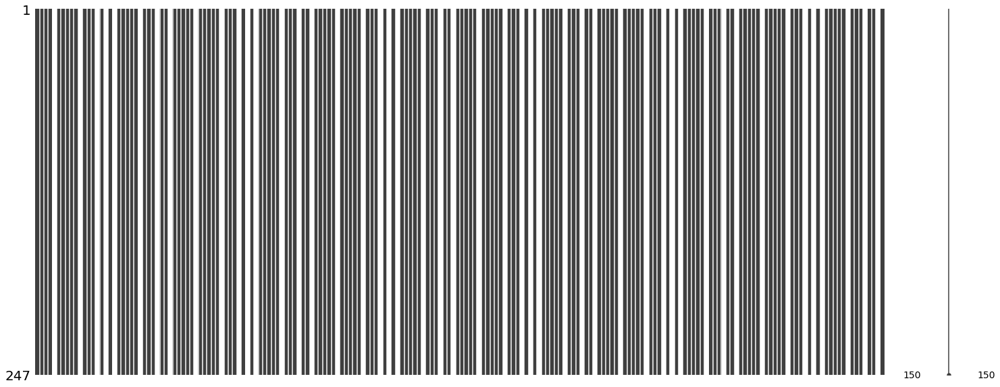

In [66]:
# areas brancas que estão com dados faltantes 

msno.matrix(cotacoes_IBOV)


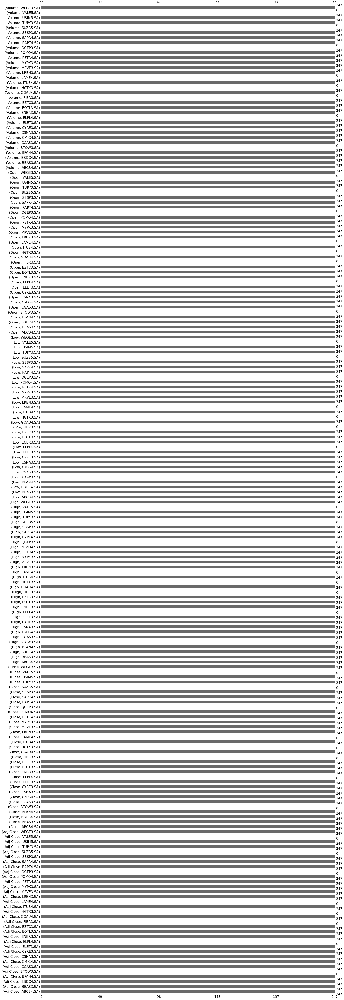

In [67]:
msno.bar(cotacoes_IBOV)

/usr/local/lib/python3.7/dist-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/usr/local/lib/python3.7/dist-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


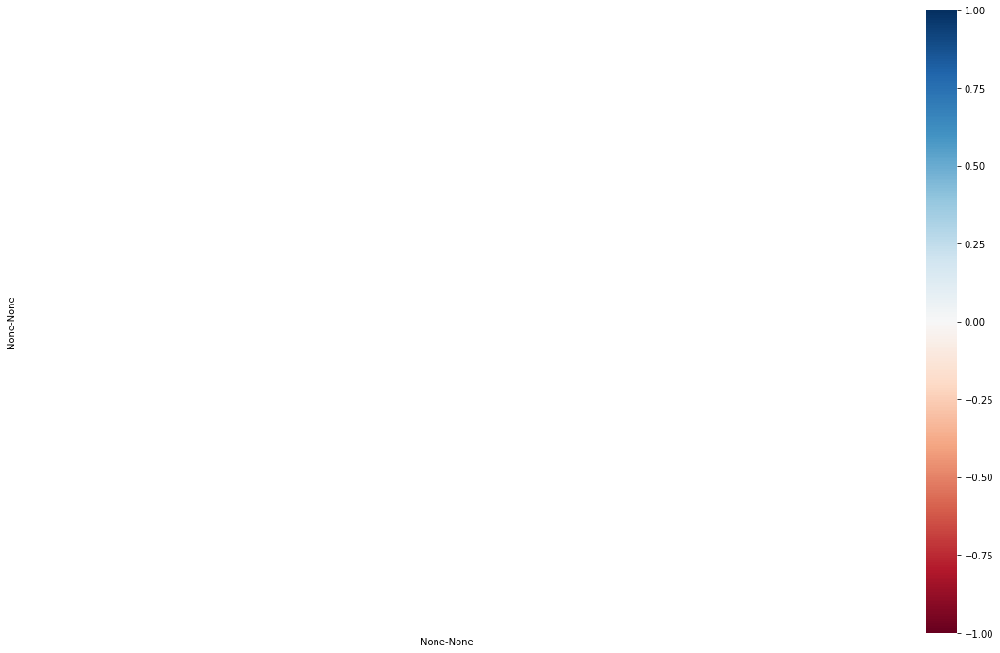

In [68]:
# Exibe a correlação entre o número de missings
# em diferentes colunas como um mapa de calor(heatmap)
# Mapa de Calor

msno.heatmap(cotacoes_IBOV);

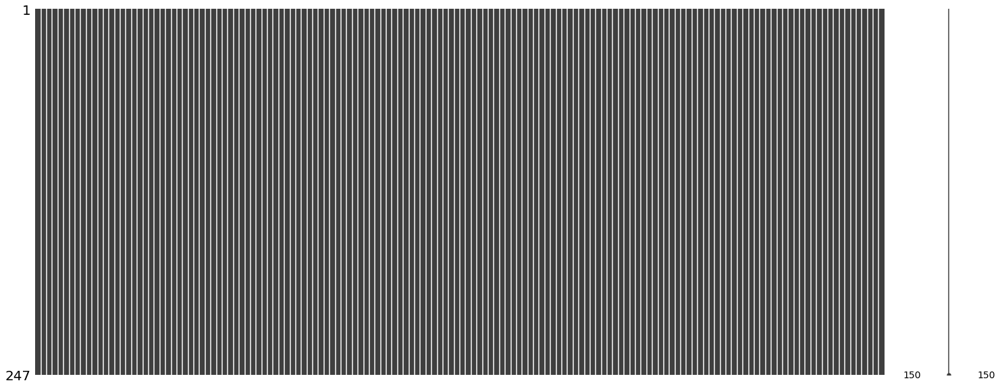

In [69]:
# nesse caso não aparece as colunas vazias
msno.matrix(cotacoes_IBOV_filter_NA)

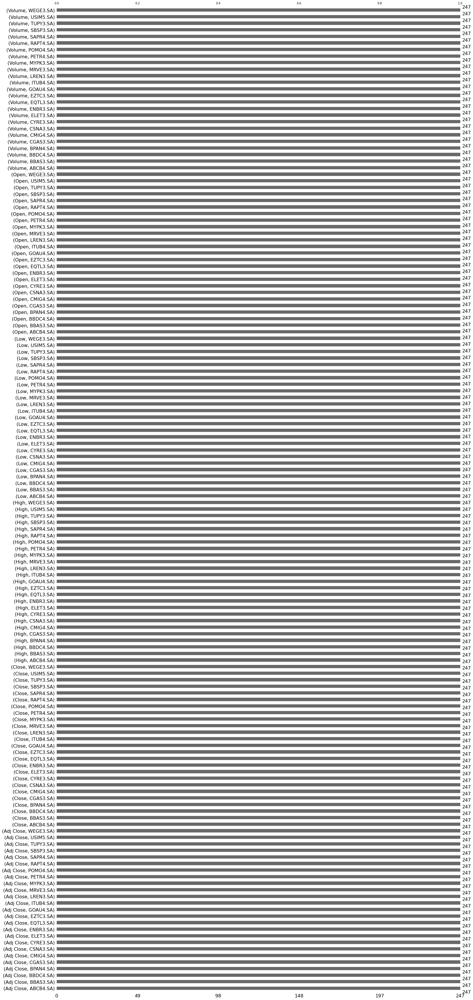

In [70]:
msno.bar(cotacoes_IBOV_filter_NA)

/usr/local/lib/python3.7/dist-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/usr/local/lib/python3.7/dist-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


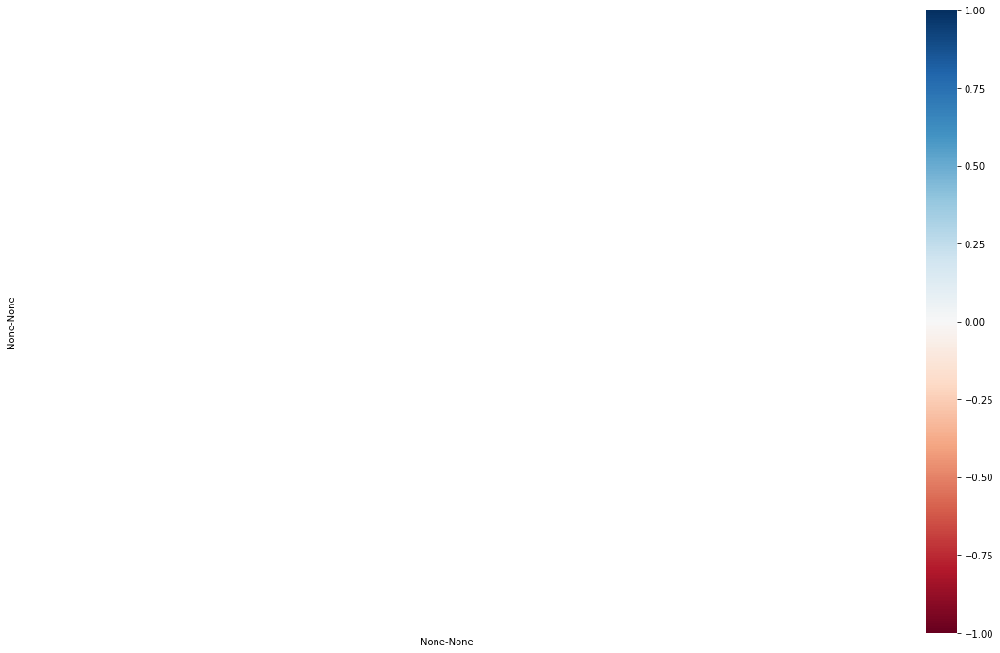

In [71]:
msno.heatmap(cotacoes_IBOV_filter_NA)

In [72]:
dados=pd.read_csv('/content/Bovespa.csv')
dados.head()

,Date,ABCB4,BBAS3,BBDC4,BPAN4,BTOW3,CGAS3,CMIG4,CSNA3,CYRE3,...,POMO4,QGEP3,RAPT4,SAPR4,SBSP3,SUZB5,TUPY3,USIM5,VALE5,WEGE3
0,6/5/2012,5.778904,13.193346,14.825962,NaN,4.67417,21.089613,16.403233,9.799454,13.011072,...,3.559332,7.938090,6.136378,4.945431,19.482090,4.228104,18.623053,7.724799,28.628716,6.314218
1,6/6/2012,5.784656,13.474055,15.421063,NaN,4.95184,21.367132,17.082111,9.838496,13.979592,...,3.727821,8.013066,6.316431,4.918369,19.842842,4.291890,18.852964,7.456715,29.472841,6.454251
2,6/8/2012,5.836405,13.488092,15.457347,NaN,5.08142,22.088638,17.082111,9.799454,14.025277,...,3.694127,7.825626,6.338035,5.256635,19.926100,4.437686,18.535686,7.635437,29.727674,6.368317
3,6/11/2012,5.922663,13.614412,15.628112,NaN,5.09993,22.088638,17.120369,9.705755,13.723758,...,3.753094,7.413257,6.482082,5.195747,20.203676,4.237216,17.629826,7.883664,29.377279,6.368317
4,6/12/2012,5.876658,13.614412,15.886813,NaN,5.34984,22.088638,17.689350,9.736986,13.632388,...,3.799433,7.413257,6.482082,5.202512,20.739265,4.146093,17.933311,7.754586,30.038250,6.365140


In [73]:
acao = 'CYRE3'

In [74]:
# Transformar Date em Data

dados.index = pd.to_datetime(dados.Date)

In [75]:
# Fazendo o Filtro 

CYRE = dados[acao]

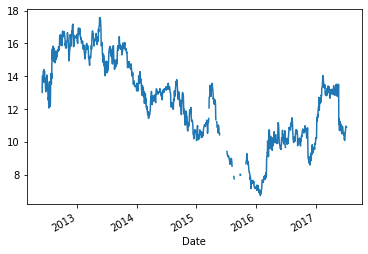

In [76]:
# espaços vazios 

CYRE.plot()

In [77]:
# passando CYRE para um DataFrame

CYRE = pd.DataFrame(CYRE)

In [78]:
# Fazendo Transformação - Pegar o trecho do dados passados e projetando para frente para preencher os dados vazios
# fazendo Dataframe.ffill
# axis = 0 preenche a linhas na vertical 

CYRE2 = CYRE.ffill(axis = 0)


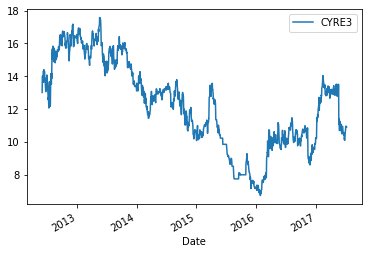

In [79]:
CYRE2.plot()

In [80]:
# usando rename pra alterar o nome da tabela CYRE3

CYRE2.columns = ['CYRE5']

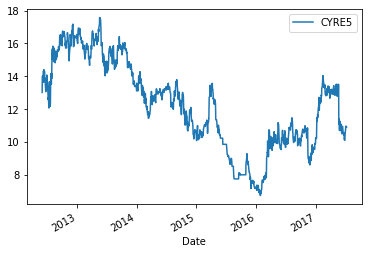

In [81]:
CYRE2.plot()

In [82]:
acao = 'WEGE3'
weg = dados[acao]

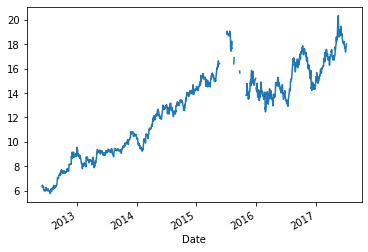

In [83]:
weg.plot()

In [84]:
# preencher os espaços vazios com '0'
weg.fillna(0)

Date
2012-06-05     6.314218
2012-06-06     6.454251
2012-06-08     6.368317
2012-06-11     6.368317
2012-06-12     6.365140
                ...    
2017-06-28    17.360371
2017-06-29    17.440098
2017-06-30    17.639414
2017-07-03    17.950001
2017-07-04    18.020000
Name: WEGE3, Length: 1257, dtype: float64

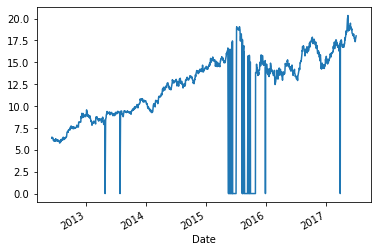

In [85]:
# Embora não recomendado para aplicações de mercado financeiro, uma opção é o preenchimento com zero
weg.fillna(0).plot()

In [86]:
# Preencher com o valor da média 

preco_medio = weg.mean()

In [87]:
weg.fillna(preco_medio, inplace = True)

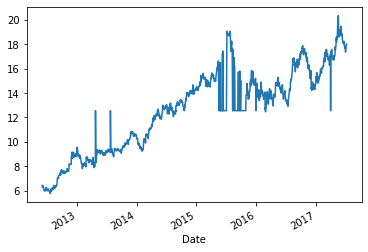

In [88]:
weg.plot();

# Módulo 3 - Aula 3: Formatação de dados

## 2.5. Redução do número de colunas - "Wide to Long"

In [89]:
# Vamos aproveitar esse dataframe sem nenhum NA e trabalhar em cima dele.
# Neste caso, vamos apenas criar uma cópia dele, deixando-o com um nome umpoouco mais simples

cotacoes_ativos = cotacoes_IBOV_filter_NA

In [90]:
cotacoes_ativos

Adj Close                                                         \
             ABCB4.SA   BBAS3.SA   BBDC4.SA   BPAN4.SA    CGAS3.SA  CMIG4.SA   
Date                                                                           
2021-01-04  14.575881  33.724125  20.752106   9.127254  151.589432  8.125487   
2021-01-05  14.368940  33.374233  20.625578   9.088247  151.654083  8.125487   
2021-01-06  14.530895  34.136818  21.309166   9.068747  151.654083  8.292133   
2021-01-07  15.016090  35.491516  21.874895   9.146757  151.654083  8.200191   
2021-01-08  14.997596  35.697861  21.686317   9.332032  156.983231  8.763343   
...               ...        ...        ...        ...         ...       ...   
2021-12-23  15.237659  28.242619  17.376768  10.815247  134.364304  9.141614   
2021-12-27  15.430908  28.300615  17.575462  10.466367  138.335510  9.197526   
2021-12-28  15.595168  28.136301  17.512241  10.496270  139.340759  9.232471   
2021-12-29  15.295633  27.991316  17.430958  10.546110  148.278473  9.113658   
2021-12-30  15.334284  27.884996  17.349674  10.645791  148.278473  9.162581   

                                                        ...     Volume  \
             CSNA3.SA   CYRE3.SA   ELET3.SA   ENBR3.SA  ...   MRVE3.SA   
Date                                                    ...              
2021-01-04  32.015358  26.252213  32.503197  16.824329  ...  3917000.0   
2021-01-05  32.596268  25.745594  31.663933  16.659697  ...  4825100.0   
2021-01-06  33.973572  25.082376  31.153080  16.624805  ...  5101800.0   
2021-01-07  36.100433  25.238970  30.934143  16.188688  ...  4820300.0   
2021-01-08  36.315929  26.445650  31.910238  16.886477  ...  9426200.0   
...               ...        ...        ...        ...  ...        ...   
2021-12-23  24.058908  14.538413  32.638519  18.824614  ...  2965500.0   
2021-12-27  24.322433  14.788578  32.618889  18.924261  ...  3224900.0   
2021-12-28  24.351715  14.798200  32.785763  18.869909  ...  3176600.0   
2021-12-29  24.439556  14.827065  32.393120  18.552841  ...  3859700.0   
2021-12-30  24.390755  15.183068  32.795578  18.969559  ...  6138500.0   

                                                                      \
             MYPK3.SA    PETR4.SA    POMO4.SA   RAPT4.SA    SAPR4.SA   
Date                                                                   
2021-01-04  3177700.0  74719700.0   6038000.0  5359600.0   8044700.0   
2021-01-05  1388800.0  95181100.0   5522900.0  2517600.0  10266800.0   
2021-01-06  2029200.0  96562500.0   6941500.0  3757700.0   7426500.0   
2021-01-07  1908900.0  56171300.0   5788800.0  3642200.0   8106000.0   
2021-01-08  1623400.0  67136300.0  19457700.0  3434500.0   6915700.0   
...               ...         ...         ...        ...         ...   
2021-12-23   885800.0  28713600.0   5473700.0  2442200.0   1669000.0   
2021-12-27  1673000.0  44227900.0   2832400.0  2096100.0   1918100.0   
2021-12-28   836300.0  30688100.0   2795700.0  1844800.0   1860200.0   
2021-12-29   776000.0  35508400.0   4142100.0  1588600.0   2067100.0   
2021-12-30  2335800.0  43229100.0   5386200.0  3155100.0   6216100.0   

                                                          
             SBSP3.SA   TUPY3.SA    USIM5.SA    WEGE3.SA  
Date                                                      
2021-01-04  5274100.0  1828900.0  20687900.0   7219800.0  
2021-01-05  4327600.0  2884200.0  18302900.0  16633600.0  
2021-01-06  5286800.0  1970700.0  23592900.0  21507400.0  
2021-01-07  4030500.0   983800.0  22298600.0  15129600.0  
2021-01-08  6990900.0  1648600.0  23237000.0  17381000.0  
...               ...        ...         ...         ...  
2021-12-23  2098900.0   260700.0  10681800.0   2166400.0  
2021-12-27  1891600.0   244700.0  10504500.0   4457200.0  
2021-12-28   735000.0   427600.0  13201600.0   3670800.0  
2021-12-29  1217400.0   365200.0  10525500.0   3091700.0  
2021-12-30  2020000.0   646300.0  12815100.0   4858300.0  

[247 rows x 150 co

#### Método melt

O melt é utilizado na biblioteca pandas para realizar uma transformação que chamamos de "wide to long".

Ou seja, se tivermos um dataframe grande e largo podemos transformá-lo num dataframe longo, com poucas mas com  muitas linhas.

O que antes eram as colunas agora viram categorias em colunas novas, as "vaiáveis", e os valores são todos mostrados na coluna valor, ou "value".

In [91]:
# Veja que a quantidade de dados é a mesma, porém agora temos apenas 3 colunas e o índice (contendo as datas). Em contrapartida, passamos a ter mais de 130 mil linhas
# Essa estrutura é especialmente interessasnte para trabalharmos com filtros, análises estatísticas e modelagens em geral

cotacoes_ativos_long =  pd.melt(cotacoes_ativos, ignore_index= False)
cotacoes_ativos_long

,variable_0,variable_1,value
Date,,,
2021-01-04,Adj Close,ABCB4.SA,1.457588e+01
2021-01-05,Adj Close,ABCB4.SA,1.436894e+01
2021-01-06,Adj Close,ABCB4.SA,1.453090e+01
2021-01-07,Adj Close,ABCB4.SA,1.501609e+01
2021-01-08,Adj Close,ABCB4.SA,1.499760e+01
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2.166400e+06
2021-12-27,Volume,WEGE3.SA,4.457200e+06
2021-12-28,Volume,WEGE3.SA,3.670800e+06


In [92]:
# Exibindo o nome das colunas

cotacoes_ativos_long.columns

Index(['variable_0', 'variable_1', 'value'], dtype='object')

## 2.6. Renomenando colunas 

In [93]:
# Usamos um dicionário para renomear as colunas, contendo as estrutura {'nome antigo' : 'novo nome'}
# axi = 1  PARA COLUNA
cotacoes_ativos_long = cotacoes_ativos_long.rename({'variable_0':'Parametro',
                             'variable_1':'Ativo',
                             'value':'Valor'}, axis = 1)

In [94]:
cotacoes_ativos_long

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,1.457588e+01
2021-01-05,Adj Close,ABCB4.SA,1.436894e+01
2021-01-06,Adj Close,ABCB4.SA,1.453090e+01
2021-01-07,Adj Close,ABCB4.SA,1.501609e+01
2021-01-08,Adj Close,ABCB4.SA,1.499760e+01
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2.166400e+06
2021-12-27,Volume,WEGE3.SA,4.457200e+06
2021-12-28,Volume,WEGE3.SA,3.670800e+06


In [95]:
# Categorias presentes na coluna "Parametro" (sem repetição)

set(cotacoes_ativos_long['Parametro'])

{'Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'}

In [96]:
# Categorias presentes na coluna "Ativo" (sem repetição)

set(cotacoes_ativos_long['Ativo'])

{'ABCB4.SA',
 'BBAS3.SA',
 'BBDC4.SA',
 'BPAN4.SA',
 'CGAS3.SA',
 'CMIG4.SA',
 'CSNA3.SA',
 'CYRE3.SA',
 'ELET3.SA',
 'ENBR3.SA',
 'EQTL3.SA',
 'EZTC3.SA',
 'GOAU4.SA',
 'ITUB4.SA',
 'LREN3.SA',
 'MRVE3.SA',
 'MYPK3.SA',
 'PETR4.SA',
 'POMO4.SA',
 'RAPT4.SA',
 'SAPR4.SA',
 'SBSP3.SA',
 'TUPY3.SA',
 'USIM5.SA',
 'WEGE3.SA'}

## 2.7 Filtros e substituições 

In [97]:
# Vamos criar uma cópia do dataframe original para fazermos algumas práticas de filtros e substituições

df_cotacoes = cotacoes_ativos_long.copy()
df_cotacoes

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,1.457588e+01
2021-01-05,Adj Close,ABCB4.SA,1.436894e+01
2021-01-06,Adj Close,ABCB4.SA,1.453090e+01
2021-01-07,Adj Close,ABCB4.SA,1.501609e+01
2021-01-08,Adj Close,ABCB4.SA,1.499760e+01
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2.166400e+06
2021-12-27,Volume,WEGE3.SA,4.457200e+06
2021-12-28,Volume,WEGE3.SA,3.670800e+06


In [98]:
# Vamos filtrar o dataframe selecionado apenas as linhas onde a coluna "Parametro" possui a categoria "Adj Close"

df_cotacoes_Adj_Close = df_cotacoes[df_cotacoes.Parametro =="Adj Close"]
df_cotacoes_Adj_Close

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,14.575881
2021-01-05,Adj Close,ABCB4.SA,14.368940
2021-01-06,Adj Close,ABCB4.SA,14.530895
2021-01-07,Adj Close,ABCB4.SA,15.016090
2021-01-08,Adj Close,ABCB4.SA,14.997596
...,...,...,...
2021-12-23,Adj Close,WEGE3.SA,33.202438
2021-12-27,Adj Close,WEGE3.SA,32.904835
2021-12-28,Adj Close,WEGE3.SA,33.023876


In [99]:
# outra forma de chamar o filtro 

df_cotacoes['Parametro']

Date
2021-01-04    Adj Close
2021-01-05    Adj Close
2021-01-06    Adj Close
2021-01-07    Adj Close
2021-01-08    Adj Close
                ...    
2021-12-23       Volume
2021-12-27       Volume
2021-12-28       Volume
2021-12-29       Volume
2021-12-30       Volume
Name: Parametro, Length: 37050, dtype: object

In [100]:
# Mesmo filtro feito de outra forma

df_cotacoes_Adj_Close = df_cotacoes[df_cotacoes['Parametro'] =="Adj Close"]
df_cotacoes_Adj_Close

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,14.575881
2021-01-05,Adj Close,ABCB4.SA,14.368940
2021-01-06,Adj Close,ABCB4.SA,14.530895
2021-01-07,Adj Close,ABCB4.SA,15.016090
2021-01-08,Adj Close,ABCB4.SA,14.997596
...,...,...,...
2021-12-23,Adj Close,WEGE3.SA,33.202438
2021-12-27,Adj Close,WEGE3.SA,32.904835
2021-12-28,Adj Close,WEGE3.SA,33.023876


In [101]:
# Filtro com mais de uma condição
# Além de filtrar a coluna 'Parametro', agora queremos estabelecer um filtro também na coluna "Valor"
# queremos selecionar as linhas que possuem valor menor de 10
# Por causa da presença do "&", as duas condições precisam ser respreitadas

# condição lógica verdadeira & verdadeira
# condição lógica verdadeira | ou ....

df_cotacoes_Adj_Close_low_cost = df_cotacoes[(df_cotacoes.Parametro =="Adj Close")&(df_cotacoes.Valor < 10)]
df_cotacoes_Adj_Close_low_cost

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,BPAN4.SA,9.127254
2021-01-05,Adj Close,BPAN4.SA,9.088247
2021-01-06,Adj Close,BPAN4.SA,9.068747
2021-01-07,Adj Close,BPAN4.SA,9.146757
2021-01-08,Adj Close,BPAN4.SA,9.332032
...,...,...,...
2021-12-23,Adj Close,SAPR4.SA,3.700973
2021-12-27,Adj Close,SAPR4.SA,3.720299
2021-12-28,Adj Close,SAPR4.SA,3.749289


In [102]:
# Selecionando apenas as linhas que possuem dados de volume

df_cotacoes_Volume = df_cotacoes[df_cotacoes['Parametro'] ==  'Volume']
df_cotacoes_Volume

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Volume,ABCB4.SA,1579948.0
2021-01-05,Volume,ABCB4.SA,1177843.0
2021-01-06,Volume,ABCB4.SA,996056.0
2021-01-07,Volume,ABCB4.SA,1018500.0
2021-01-08,Volume,ABCB4.SA,1407000.0
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2166400.0
2021-12-27,Volume,WEGE3.SA,4457200.0
2021-12-28,Volume,WEGE3.SA,3670800.0


In [103]:
# Calculando a mediana do valor de Volume de todos os papéis

volume_mediano = np.median(df_cotacoes_Volume.Valor)
volume_mediano

5938000.0

In [104]:
# Vamos selecionar apenas os preções onde o volume negociado por ativo foi acima da mediana de volume calculada acima

df_cotacoes[(df_cotacoes.Valor > volume_mediano)]

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Volume,BBAS3.SA,13874600.0
2021-01-05,Volume,BBAS3.SA,15954000.0
2021-01-06,Volume,BBAS3.SA,20566700.0
2021-01-07,Volume,BBAS3.SA,21878700.0
2021-01-08,Volume,BBAS3.SA,16240300.0
...,...,...,...
2021-12-08,Volume,WEGE3.SA,11021000.0
2021-12-09,Volume,WEGE3.SA,16902100.0
2021-12-13,Volume,WEGE3.SA,7824400.0


In [105]:
# Vamos complicar um pouco mais
# Além do filtro acima, vamos criar um outro filtro onde a colluna Parametro  precisa ser "Adj Close" e o valor precisa ser menor que 10 OU maior que 80
df_cotacoes[(df_cotacoes.Parametro =="Adj Close")&((df_cotacoes.Valor < 10) | (df_cotacoes. Valor > 80 ))]

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,BPAN4.SA,9.127254
2021-01-05,Adj Close,BPAN4.SA,9.088247
2021-01-06,Adj Close,BPAN4.SA,9.068747
2021-01-07,Adj Close,BPAN4.SA,9.146757
2021-01-08,Adj Close,BPAN4.SA,9.332032
...,...,...,...
2021-12-23,Adj Close,SAPR4.SA,3.700973
2021-12-27,Adj Close,SAPR4.SA,3.720299
2021-12-28,Adj Close,SAPR4.SA,3.749289


In [106]:
# Vamos selecionar ativos com base em uma lista
# Ou seja, precisamos filtrar as linhas de tal forma que contenham apenas os papéis que determinamos na lista 
ativos_churrasco = ['PETR4.SA','ABCB4.SA','BBAS3.SA','SAPR4.SA','RADL3.SA']
df_cotacoes_churrasco = df_cotacoes[df_cotacoes.Ativo.isin(ativos_churrasco)]
df_cotacoes_churrasco

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,1.457588e+01
2021-01-05,Adj Close,ABCB4.SA,1.436894e+01
2021-01-06,Adj Close,ABCB4.SA,1.453090e+01
2021-01-07,Adj Close,ABCB4.SA,1.501609e+01
2021-01-08,Adj Close,ABCB4.SA,1.499760e+01
...,...,...,...
2021-12-23,Volume,SAPR4.SA,1.669000e+06
2021-12-27,Volume,SAPR4.SA,1.918100e+06
2021-12-28,Volume,SAPR4.SA,1.860200e+06


In [107]:
# Como selecionar todos os papéis que não estão na lista?

alguns_bancos = ['ITUB4.SA','BBDC4.SA','BBAS3.SA','SANB11.SA','BIDI11.SA']
df_cotacoes_nao_bancos = df_cotacoes[~df_cotacoes.Ativo.isin(alguns_bancos)]
df_cotacoes_nao_bancos

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4.SA,1.457588e+01
2021-01-05,Adj Close,ABCB4.SA,1.436894e+01
2021-01-06,Adj Close,ABCB4.SA,1.453090e+01
2021-01-07,Adj Close,ABCB4.SA,1.501609e+01
2021-01-08,Adj Close,ABCB4.SA,1.499760e+01
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2.166400e+06
2021-12-27,Volume,WEGE3.SA,4.457200e+06
2021-12-28,Volume,WEGE3.SA,3.670800e+06


In [108]:
# Vamos lembrar como funciona o .loc

df_cotacoes_index = df_cotacoes.loc['2021-03-26']
df_cotacoes_index

,Parametro,Ativo,Valor
Date,,,
2021-03-26,Adj Close,ABCB4.SA,1.352742e+01
2021-03-26,Adj Close,BBAS3.SA,2.714979e+01
2021-03-26,Adj Close,BBDC4.SA,2.110984e+01
2021-03-26,Adj Close,BPAN4.SA,1.051194e+01
2021-03-26,Adj Close,CGAS3.SA,1.394479e+02
...,...,...,...
2021-03-26,Volume,SAPR4.SA,5.259100e+06
2021-03-26,Volume,SBSP3.SA,4.137700e+06
2021-03-26,Volume,TUPY3.SA,7.054000e+05


In [109]:
# Utilizando o operador 'date_range" para retornar todas as datas que estão  presentes em um intervalo 

data_range_IBOV = pd.date_range(start = '2021-03-21', end = '2021-03-31')
data_range_IBOV

DatetimeIndex(['2021-03-21', '2021-03-22', '2021-03-23', '2021-03-24',
               '2021-03-25', '2021-03-26', '2021-03-27', '2021-03-28',
               '2021-03-29', '2021-03-30', '2021-03-31'],
              dtype='datetime64[ns]', freq='D')

In [110]:
# Utilizando o elemento construído na célula anterior, vamos selecionar as linhas do nosso data frame de ativos que contém apenas
# o intervalo de dats determinado acima

df_cotacoes_index_range = df_cotacoes[df_cotacoes.index.isin(data_range_IBOV)]
df_cotacoes_index_range

,Parametro,Ativo,Valor
Date,,,
2021-03-22,Adj Close,ABCB4.SA,1.398050e+01
2021-03-23,Adj Close,ABCB4.SA,1.379557e+01
2021-03-24,Adj Close,ABCB4.SA,1.359215e+01
2021-03-25,Adj Close,ABCB4.SA,1.337948e+01
2021-03-26,Adj Close,ABCB4.SA,1.352742e+01
...,...,...,...
2021-03-25,Volume,WEGE3.SA,1.157660e+07
2021-03-26,Volume,WEGE3.SA,1.113440e+07
2021-03-29,Volume,WEGE3.SA,9.868800e+06


In [111]:
# ação preferencial termina em 4 |  acao ordinaria termina em 3
# Lembrando dos operadores de filtros em strings, veja como fazemos para retornar o quinto caractere do ticker de um papel

acao = 'PETRO4.SA'
acao[-4]

'4'

Dado isso, como podemos fazer para retornar apenas as ações ordinárias, ou seja,  que têm final '3'?

In [112]:
df_cotacoes.Ativo.str[-4]

Date
2021-01-04    4
2021-01-05    4
2021-01-06    4
2021-01-07    4
2021-01-08    4
             ..
2021-12-23    3
2021-12-27    3
2021-12-28    3
2021-12-29    3
2021-12-30    3
Name: Ativo, Length: 37050, dtype: object

In [113]:
# Dado o que aprendemos acima, basta então criar uma confição lógica de  forma que 'df_cotacoes.Ativo.str[-4] seja igual a '3'
# Nesse caso, temos todos os dados desses ativos 

df_cotacoes_ordinarias = df_cotacoes[df_cotacoes.Ativo.str[-4] == '3']

In [114]:
df_cotacoes_ordinarias

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,BBAS3.SA,3.372412e+01
2021-01-05,Adj Close,BBAS3.SA,3.337423e+01
2021-01-06,Adj Close,BBAS3.SA,3.413682e+01
2021-01-07,Adj Close,BBAS3.SA,3.549152e+01
2021-01-08,Adj Close,BBAS3.SA,3.569786e+01
...,...,...,...
2021-12-23,Volume,WEGE3.SA,2.166400e+06
2021-12-27,Volume,WEGE3.SA,4.457200e+06
2021-12-28,Volume,WEGE3.SA,3.670800e+06


In [115]:


set(df_cotacoes_ordinarias['Ativo'])

{'BBAS3.SA',
 'CGAS3.SA',
 'CSNA3.SA',
 'CYRE3.SA',
 'ELET3.SA',
 'ENBR3.SA',
 'EQTL3.SA',
 'EZTC3.SA',
 'LREN3.SA',
 'MRVE3.SA',
 'MYPK3.SA',
 'SBSP3.SA',
 'TUPY3.SA',
 'WEGE3.SA'}

In [116]:
# .SA$ - faz que não tenha nada depois 
# ^.SA - faz que não tenha nada na frente
# regex - expressões  regulares

# Para remover os ".SA" dos tickers, precisamos usar um método chamado "replace"
# Precisamos indicar o que queremos remover e o que virá no lugar
# r'.SA$' nos indica qualquer palavra terminada em .SA


df_cotacoes_semSA = df_cotacoes.replace(to_replace = r'.SA$', value = '', regex = True)
df_cotacoes_semSA

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,1.457588e+01
2021-01-05,Adj Close,ABCB4,1.436894e+01
2021-01-06,Adj Close,ABCB4,1.453090e+01
2021-01-07,Adj Close,ABCB4,1.501609e+01
2021-01-08,Adj Close,ABCB4,1.499760e+01
...,...,...,...
2021-12-23,Volume,WEGE3,2.166400e+06
2021-12-27,Volume,WEGE3,4.457200e+06
2021-12-28,Volume,WEGE3,3.670800e+06


In [117]:
# Para trocar "VVIA" por "VVAR", o raciocínnio é o mesmo:
# Nesse caso, ^ para indicar uma string que comece com VIIA

df_cotacoes_ativo_alterado = df_cotacoes.replace(to_replace = r'^VIIA', value = 'VVAR', regex = True)
set(df_cotacoes_ativo_alterado.Ativo)

{'ABCB4.SA',
 'BBAS3.SA',
 'BBDC4.SA',
 'BPAN4.SA',
 'CGAS3.SA',
 'CMIG4.SA',
 'CSNA3.SA',
 'CYRE3.SA',
 'ELET3.SA',
 'ENBR3.SA',
 'EQTL3.SA',
 'EZTC3.SA',
 'GOAU4.SA',
 'ITUB4.SA',
 'LREN3.SA',
 'MRVE3.SA',
 'MYPK3.SA',
 'PETR4.SA',
 'POMO4.SA',
 'RAPT4.SA',
 'SAPR4.SA',
 'SBSP3.SA',
 'TUPY3.SA',
 'USIM5.SA',
 'WEGE3.SA'}

## 2.8 Duplicadas

In [118]:
# Método mostra qual as duplicadas

df_cotacoes_semSA.duplicated()

Date
2021-01-04    False
2021-01-05    False
2021-01-06    False
2021-01-07    False
2021-01-08    False
              ...  
2021-12-23    False
2021-12-27    False
2021-12-28    False
2021-12-29    False
2021-12-30    False
Length: 37050, dtype: bool

In [119]:
# faz uma análise mais global 

df_cotacoes_semSA.duplicated().any()

True

Ou seja, então há duplicadas. Vamos fazer uma verificação mais precisa coluna a coluna

In [120]:

df_cotacoes_semSA['Parametro'].duplicated().any()
df_cotacoes_semSA['Ativo'].duplicated().any()
df_cotacoes_semSA['Valor'].duplicated().any()

True

In [121]:
print(df_cotacoes_semSA['Parametro'].duplicated().any(),
df_cotacoes_semSA['Ativo'].duplicated().any(),
df_cotacoes_semSA['Valor'].duplicated().any())

True True True


In [122]:
# Quantidade de linhas duplicadas 
df_cotacoes_semSA[df_cotacoes_semSA.duplicated(keep = False)]



,Parametro,Ativo,Valor
Date,,,
2021-01-13,Adj Close,ABCB4,1.474794e+01
2021-01-19,Adj Close,ABCB4,1.470171e+01
2021-01-26,Adj Close,ABCB4,1.413768e+01
2021-01-27,Adj Close,ABCB4,1.398975e+01
2021-02-03,Adj Close,ABCB4,1.470171e+01
...,...,...,...
2021-08-03,Volume,TUPY3,1.063300e+06
2021-08-13,Volume,TUPY3,7.031000e+05
2021-09-01,Volume,TUPY3,9.838000e+05


In [123]:
df_cotacoes_semSA.shape

(37050, 3)

In [124]:
# Para remover as duplicadas

sem_duplicadas = df_cotacoes_semSA.drop_duplicates(subset = ['Parametro','Ativo','Valor'], keep = False)
sem_duplicadas.shape

(26351, 3)

In [125]:
sem_duplicadas.head()

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,14.575881
2021-01-05,Adj Close,ABCB4,14.368940
2021-01-06,Adj Close,ABCB4,14.530895
2021-01-07,Adj Close,ABCB4,15.016090
2021-01-08,Adj Close,ABCB4,14.997596


## 2.9. Drop 

Trata-se da função que deve ser utilizada quando precisamos remover linhas ou colunas 

In [126]:
sem_duplicadas.index

DatetimeIndex(['2021-01-04', '2021-01-05', '2021-01-06', '2021-01-07',
               '2021-01-08', '2021-01-11', '2021-01-12', '2021-01-14',
               '2021-01-15', '2021-01-18',
               ...
               '2021-12-16', '2021-12-17', '2021-12-20', '2021-12-21',
               '2021-12-22', '2021-12-23', '2021-12-27', '2021-12-28',
               '2021-12-29', '2021-12-30'],
              dtype='datetime64[ns]', name='Date', length=26351, freq=None)

In [127]:
# transformando em formato de hota e data

pd.to_datetime('2021-01-04')

Timestamp('2021-01-04 00:00:00')

In [128]:
# removendo datas

a = pd.to_datetime('2021-01-04')
b = pd.to_datetime('2021-01-05')
c = pd.to_datetime('2021-01-06')

In [129]:
# removendo na linhas

sem_duplicadas.drop([a,b,c])

,Parametro,Ativo,Valor
Date,,,
2021-01-07,Adj Close,ABCB4,1.501609e+01
2021-01-08,Adj Close,ABCB4,1.499760e+01
2021-01-11,Adj Close,ABCB4,1.467397e+01
2021-01-12,Adj Close,ABCB4,1.502534e+01
2021-01-14,Adj Close,ABCB4,1.527499e+01
...,...,...,...
2021-12-23,Volume,WEGE3,2.166400e+06
2021-12-27,Volume,WEGE3,4.457200e+06
2021-12-28,Volume,WEGE3,3.670800e+06


In [130]:
# Observe acima que as datas escolhidas sumiram do dataframe

# removendo coluna | local  pois não usamos implace = True

sem_duplicadas.drop(['Valor'], axis = 1)

,Parametro,Ativo
Date,,
2021-01-04,Adj Close,ABCB4
2021-01-05,Adj Close,ABCB4
2021-01-06,Adj Close,ABCB4
2021-01-07,Adj Close,ABCB4
2021-01-08,Adj Close,ABCB4
...,...,...
2021-12-23,Volume,WEGE3
2021-12-27,Volume,WEGE3
2021-12-28,Volume,WEGE3


In [131]:
sem_duplicadas.columns[[0,1]]

Index(['Parametro', 'Ativo'], dtype='object')

In [132]:
# Podemos remover pelo índice da coluna

sem_duplicadas.drop(sem_duplicadas.columns[[0,1]], axis=1)

,Valor
Date,
2021-01-04,1.457588e+01
2021-01-05,1.436894e+01
2021-01-06,1.453090e+01
2021-01-07,1.501609e+01
2021-01-08,1.499760e+01
...,...
2021-12-23,2.166400e+06
2021-12-27,4.457200e+06
2021-12-28,3.670800e+06


# Exercício

Filtre os dados do Adjusted Close de ABCB4, e depois remova as linhas correspondentes aos meses de Abril e maior

In [133]:
sem_duplicadas.head()

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,14.575881
2021-01-05,Adj Close,ABCB4,14.368940
2021-01-06,Adj Close,ABCB4,14.530895
2021-01-07,Adj Close,ABCB4,15.016090
2021-01-08,Adj Close,ABCB4,14.997596


Esse dataframe contém dados de vários papéis, e além disso, a coluna parâmetro tem várias categorias como 'Adj Close', 'Close', etc.

Logo, precisamos criar um filtro composto onde especificamos o ativo e parâmetro

In [134]:
# Criando filtro composto

abcb = sem_duplicadas[(sem_duplicadas['Ativo']== 'ABCB4')&(sem_duplicadas['Parametro']== 'Adj Close')]

O nosso conjunto inicial de dados, é portanto, este representado no gráfico:


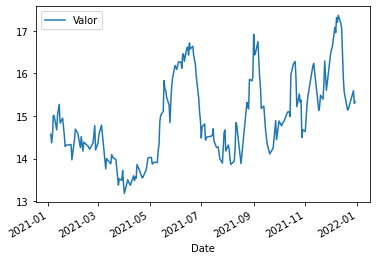

In [135]:
abcb.plot()

# A primeira etapa é a criação de um objeto do tipo 'date range' usando a função  pd.date_range() da biblioteca pandas.


In [136]:
data_range = pd.date_range(start = '2021-04-01', end = '2021-05-31')
data_range

DatetimeIndex(['2021-04-01', '2021-04-02', '2021-04-03', '2021-04-04',
               '2021-04-05', '2021-04-06', '2021-04-07', '2021-04-08',
               '2021-04-09', '2021-04-10', '2021-04-11', '2021-04-12',
               '2021-04-13', '2021-04-14', '2021-04-15', '2021-04-16',
               '2021-04-17', '2021-04-18', '2021-04-19', '2021-04-20',
               '2021-04-21', '2021-04-22', '2021-04-23', '2021-04-24',
               '2021-04-25', '2021-04-26', '2021-04-27', '2021-04-28',
               '2021-04-29', '2021-04-30', '2021-05-01', '2021-05-02',
               '2021-05-03', '2021-05-04', '2021-05-05', '2021-05-06',
               '2021-05-07', '2021-05-08', '2021-05-09', '2021-05-10',
               '2021-05-11', '2021-05-12', '2021-05-13', '2021-05-14',
               '2021-05-15', '2021-05-16', '2021-05-17', '2021-05-18',
               '2021-05-19', '2021-05-20', '2021-05-21', '2021-05-22',
               '2021-05-23', '2021-05-24', '2021-05-25', '2021-05-26',
      

Agora vamos remover as linhas que correspondem a essas data !

In [137]:
type(data_range)

pandas.core.indexes.datetimes.DatetimeIndex

In [138]:
# erros - passa pelo erro se for simples
# Verifique que as datas correspondentes ao intervalo que definimos acima desaparecem do gráfico

abcb.drop(data_range, errors ='ignore')

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,14.575881
2021-01-05,Adj Close,ABCB4,14.368940
2021-01-06,Adj Close,ABCB4,14.530895
2021-01-07,Adj Close,ABCB4,15.016090
2021-01-08,Adj Close,ABCB4,14.997596
...,...,...,...
2021-12-22,Adj Close,ABCB4,15.160359
2021-12-23,Adj Close,ABCB4,15.237659
2021-12-28,Adj Close,ABCB4,15.595168


In [139]:
# para exibir os datadrames inteiros

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  


In [140]:
# mostrando o resultado 

abcb.drop(data_range, errors ='ignore')

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,14.575881
2021-01-05,Adj Close,ABCB4,14.368940
2021-01-06,Adj Close,ABCB4,14.530895
2021-01-07,Adj Close,ABCB4,15.016090
2021-01-08,Adj Close,ABCB4,14.997596
2021-01-11,Adj Close,ABCB4,14.673974
2021-01-12,Adj Close,ABCB4,15.025336
2021-01-14,Adj Close,ABCB4,15.274988
2021-01-15,Adj Close,ABCB4,14.831163


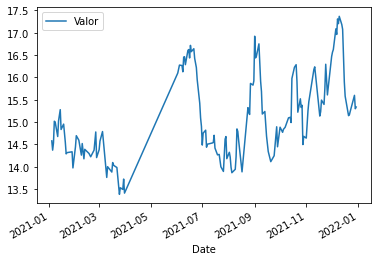

In [141]:
abcb.drop(data_range, errors = 'ignore').plot()

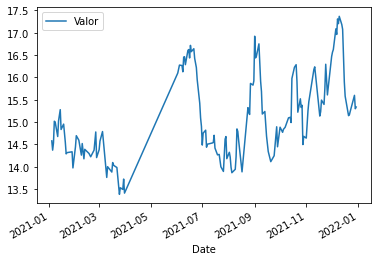

In [142]:
# simplificando a função drop
# Fazendo a operação em apenas 1 linha 

abcb.drop(pd.date_range(start = '2021-04-01', end = '2021-05-31'), errors = 'ignore').plot()

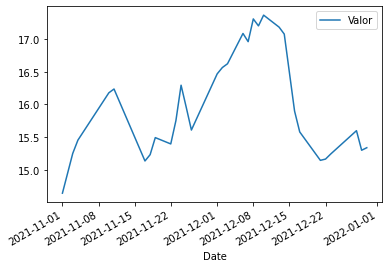

In [143]:
# Mantendo apenas novembro e dezembro

# Podemos fazer essa operação em apenas 1 linha

abcb.drop(pd.date_range(start = '2021-01-01', end = '2021-10-31'), errors = 'ignore').plot()

# Módulo 3 - Aula 4: Agregação de dados
## Consolidação de dataframes

Veremos nessa seção alguns métodos e ferramentas para criar novos dataframes com base em dataframes pré-existentes

Essas operações vão nos possibilitar condensar os dataframes originais em novos de tal forma que consigamos reter a maior parte das informações relevantes

Exemplo:

1.count 

2.concat 

3.group by 

4.merge (join)

## 3.1. count

Conta célulars que não são NAs para cada linha ou coluna

Lembre-se sempre de consultar a documentação oficial da biblioteca e da função em caso de da
https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.count.html

In [144]:
df_cotacoes_semSA.count()

Parametro    37050
Ativo        37050
Valor        37050
dtype: int64

In [145]:
df_cotacoes_semSA.count(axis = 0)

Parametro    37050
Ativo        37050
Valor        37050
dtype: int64

In [146]:
# linhas inteiras 

df_cotacoes_semSA.count(axis = 1)

Date
2021-01-04    3
2021-01-05    3
2021-01-06    3
2021-01-07    3
2021-01-08    3
2021-01-11    3
2021-01-12    3
2021-01-13    3
2021-01-14    3
2021-01-15    3
2021-01-18    3
2021-01-19    3
2021-01-20    3
2021-01-21    3
2021-01-22    3
2021-01-26    3
2021-01-27    3
2021-01-28    3
2021-01-29    3
2021-02-01    3
2021-02-02    3
2021-02-03    3
2021-02-04    3
2021-02-05    3
2021-02-08    3
2021-02-09    3
2021-02-10    3
2021-02-11    3
2021-02-12    3
2021-02-17    3
2021-02-18    3
2021-02-19    3
2021-02-22    3
2021-02-23    3
2021-02-24    3
2021-02-25    3
2021-02-26    3
2021-03-01    3
2021-03-02    3
2021-03-03    3
2021-03-04    3
2021-03-05    3
2021-03-08    3
2021-03-09    3
2021-03-10    3
2021-03-11    3
2021-03-12    3
2021-03-15    3
2021-03-16    3
2021-03-17    3
2021-03-18    3
2021-03-19    3
2021-03-22    3
2021-03-23    3
2021-03-24    3
2021-03-25    3
2021-03-26    3
2021-03-29    3
2021-03-30    3
2021-03-31    3
2021-04-01    3
2021-04-05    3
202

# 3. Consolidação de dataframes

Veremos nessa seção alguns métodos e ferramentas para criar novos dataframes com base em dataframes pré-existentes
Essas perações vão nos possibilitar condensar os dataframes originais em novos de tal forma que consigamos reter a maior parte 
das informaç~eos relevantes

Exemplos:
1. count
2. concat
3. group by
4. merge(join)

## 3.1. count

Conta células que não são NAs para cada linha ou coluna.

Lembre-se sempre de consultar a documentação oficial da biblioteca e da função em caso de dúvida
https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.count.html

In [147]:
df_cotacoes_semSA.count(axis = 0)

Parametro    37050
Ativo        37050
Valor        37050
dtype: int64

In [148]:
df_cotacoes_semSA.count(axis = 1)

Date
2021-01-04    3
2021-01-05    3
2021-01-06    3
2021-01-07    3
2021-01-08    3
2021-01-11    3
2021-01-12    3
2021-01-13    3
2021-01-14    3
2021-01-15    3
2021-01-18    3
2021-01-19    3
2021-01-20    3
2021-01-21    3
2021-01-22    3
2021-01-26    3
2021-01-27    3
2021-01-28    3
2021-01-29    3
2021-02-01    3
2021-02-02    3
2021-02-03    3
2021-02-04    3
2021-02-05    3
2021-02-08    3
2021-02-09    3
2021-02-10    3
2021-02-11    3
2021-02-12    3
2021-02-17    3
2021-02-18    3
2021-02-19    3
2021-02-22    3
2021-02-23    3
2021-02-24    3
2021-02-25    3
2021-02-26    3
2021-03-01    3
2021-03-02    3
2021-03-03    3
2021-03-04    3
2021-03-05    3
2021-03-08    3
2021-03-09    3
2021-03-10    3
2021-03-11    3
2021-03-12    3
2021-03-15    3
2021-03-16    3
2021-03-17    3
2021-03-18    3
2021-03-19    3
2021-03-22    3
2021-03-23    3
2021-03-24    3
2021-03-25    3
2021-03-26    3
2021-03-29    3
2021-03-30    3
2021-03-31    3
2021-04-01    3
2021-04-05    3
202

Utilizamos o operador unique para entender sobre as categorias em numa variável (coluna)

In [149]:
df_cotacoes_semSA.Ativo.unique()

array(['ABCB4', 'BBAS3', 'BBDC4', 'BPAN4', 'CGAS3', 'CMIG4', 'CSNA3',
       'CYRE3', 'ELET3', 'ENBR3', 'EQTL3', 'EZTC3', 'GOAU4', 'ITUB4',
       'LREN3', 'MRVE3', 'MYPK3', 'PETR4', 'POMO4', 'RAPT4', 'SAPR4',
       'SBSP3', 'TUPY3', 'USIM5', 'WEGE3'], dtype=object)

In [150]:
df_cotacoes_semSA.Parametro.unique()

array(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'],
      dtype=object)

In [151]:
df_cotacoes_semSA.Valor.unique()

array([1.45758810e+01, 1.43689404e+01, 1.45308952e+01, ...,
       4.45720000e+06, 3.09170000e+06, 4.85830000e+06])

Junto á função len(), conseguimos obter o número de categorias presentes em cada variável

In [152]:
len(df_cotacoes_semSA.Ativo.unique())

25

In [153]:
len(df_cotacoes_semSA.Parametro.unique())

6

In [154]:
len(df_cotacoes_semSA.Valor.unique())

16774

# 3.2 Concatenar outros DFs e reorganizar colunas

In [155]:
IBOV_shares = df_cotacoes_semSA.copy()
IBOV_shares.head()

,Parametro,Ativo,Valor
Date,,,
2021-01-04,Adj Close,ABCB4,14.575881
2021-01-05,Adj Close,ABCB4,14.368940
2021-01-06,Adj Close,ABCB4,14.530895
2021-01-07,Adj Close,ABCB4,15.016090
2021-01-08,Adj Close,ABCB4,14.997596


In [156]:
# Criando colunas

Dia_semana = pd.to_datetime(IBOV_shares.index).strftime('%A')
Dia_semana

Index(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Monday',
       'Tuesday', 'Wednesday', 'Thursday', 'Friday',
       ...
       'Thursday', 'Friday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday',
       'Monday', 'Tuesday', 'Wednesday', 'Thursday'],
      dtype='object', name='Date', length=37050)

In [157]:
# insira o dia semana na coluna 

IBOV_shares.insert(0,'Dia_semana',Dia_semana)


In [158]:
IBOV_shares.head()

,Dia_semana,Parametro,Ativo,Valor
Date,,,,
2021-01-04,Monday,Adj Close,ABCB4,14.575881
2021-01-05,Tuesday,Adj Close,ABCB4,14.368940
2021-01-06,Wednesday,Adj Close,ABCB4,14.530895
2021-01-07,Thursday,Adj Close,ABCB4,15.016090
2021-01-08,Friday,Adj Close,ABCB4,14.997596


In [159]:
# Ajustando formatação do Mês e transformando num novo dataframe
Mes = pd.to_datetime(IBOV_shares.index).strftime('%B')
Mes

Index(['January', 'January', 'January', 'January', 'January', 'January',
       'January', 'January', 'January', 'January',
       ...
       'December', 'December', 'December', 'December', 'December', 'December',
       'December', 'December', 'December', 'December'],
      dtype='object', name='Date', length=37050)

In [160]:
# Transformando em dataframe
Mes = pd.DataFrame(Mes)


In [161]:
# Mudando nome da coluna

Mes = Mes.rename({'Date':'Mes'}, axis = 1)

In [162]:
# Ajustando o índice para que seja o mesmo o dataframe IBOV_shares, ou seja, o índice passará a ser a data 

Mes.index = IBOV_shares.index
Mes

,Mes
Date,
2021-01-04,January
2021-01-05,January
2021-01-06,January
2021-01-07,January
2021-01-08,January
2021-01-11,January
2021-01-12,January
2021-01-13,January
2021-01-14,January


In [163]:
# Ajustando formatação do ano e transformando num novo dataframe

Ano = pd.DataFrame(pd.to_datetime(IBOV_shares.index).strftime('%Y'))

# Mudando o nome da coluna

Ano = Ano.rename({'Date':'Ano'}, axis = 1)

# Ajustando o índice para que seja o mesmo do dataframe IBOV_shares, ou seja, o índice passará a ser a data 
Ano.index = IBOV_shares.index

Ano

,Ano
Date,
2021-01-04,2021
2021-01-05,2021
2021-01-06,2021
2021-01-07,2021
2021-01-08,2021
2021-01-11,2021
2021-01-12,2021
2021-01-13,2021
2021-01-14,2021


In [164]:
ibov_data = pd.concat([Mes,Ano], axis = 1)
ibov_data.head()

,Mes,Ano
Date,,
2021-01-04,January,2021
2021-01-05,January,2021
2021-01-06,January,2021
2021-01-07,January,2021
2021-01-08,January,2021


In [165]:
# Agora juntando com o dataframe original com os dados dos papéis

IBOV_shares_datas = pd.concat([IBOV_shares,ibov_data], axis = 1)
IBOV_shares_datas.head()

,Dia_semana,Parametro,Ativo,Valor,Mes,Ano
Date,,,,,,
2021-01-04,Monday,Adj Close,ABCB4,14.575881,January,2021
2021-01-05,Tuesday,Adj Close,ABCB4,14.368940,January,2021
2021-01-06,Wednesday,Adj Close,ABCB4,14.530895,January,2021
2021-01-07,Thursday,Adj Close,ABCB4,15.016090,January,2021
2021-01-08,Friday,Adj Close,ABCB4,14.997596,January,2021


In [166]:
# Vamos mudar a ordem das colunas


# Determine a nova ordem que deseja
col_nova_ordem = ['Ano','Mes','Dia_semana','Parametro','Ativo','Valor']
IBOV_shares_datas = IBOV_shares_datas[col_nova_ordem]
IBOV_shares_datas.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Valor
Date,,,,,,
2021-01-04,2021,January,Monday,Adj Close,ABCB4,14.575881
2021-01-05,2021,January,Tuesday,Adj Close,ABCB4,14.368940
2021-01-06,2021,January,Wednesday,Adj Close,ABCB4,14.530895
2021-01-07,2021,January,Thursday,Adj Close,ABCB4,15.016090
2021-01-08,2021,January,Friday,Adj Close,ABCB4,14.997596


In [167]:
set(IBOV_shares_datas.Parametro)

{'Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'}

### Reconstrução do dataframe

Utilizando o conhecimento que adquirimos até aqui sobre formatação de data frames e junção usando a função concat, vamos tentar recuperar a formatação que tinhamos nos dados das ações antes de executar o melt. Andes disso, tinhamos a estrutura OHLC

In [168]:
# Inicalmente vamos criar novos dataframes, de tal forma que cada informação de negociação será um data frame separado.
# por exemplo, teremos um data frame para dados de abertura (Open), máxima, mínima, etc.

IBOV_Open = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'Open']
IBOV_High = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'High']
IBOV_Low = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'Low']
IBOV_Close = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'Close']
IBOV_Adj_Close = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'Adj Close']
IBOV_Volume = IBOV_shares_datas[IBOV_shares_datas.Parametro == 'Volume']



In [169]:
# Exemplo

IBOV_Open.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Valor
Date,,,,,,
2021-01-04,2021,January,Monday,Open,ABCB4,15.794977
2021-01-05,2021,January,Tuesday,Open,ABCB4,16.142883
2021-01-06,2021,January,Wednesday,Open,ABCB4,15.904319
2021-01-07,2021,January,Thursday,Open,ABCB4,15.860000
2021-01-08,2021,January,Friday,Open,ABCB4,16.270000


In [170]:
# Renomeado as colunas 'Value' de cada um dos dataframes para que faça mais sentido, e não cause problemas quando juntarmos todos eles
# OBS.: O Warning não significa erro.


IBOV_Open.rename(columns = {'Valor': 'Open'}, inplace = True)
IBOV_High.rename(columns = {'Valor': 'High'}, inplace = True)
IBOV_Low.rename(columns = {'Valor': 'Low'}, inplace = True)
IBOV_Close.rename(columns = {'Valor': 'Close'}, inplace = True)
IBOV_Adj_Close.rename(columns = {'Valor': 'Adj Close'}, inplace = True)
IBOV_Volume.rename(columns = {'Valor': 'Volume'}, inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [171]:
IBOV_Open.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Open
Date,,,,,,
2021-01-04,2021,January,Monday,Open,ABCB4,15.794977
2021-01-05,2021,January,Tuesday,Open,ABCB4,16.142883
2021-01-06,2021,January,Wednesday,Open,ABCB4,15.904319
2021-01-07,2021,January,Thursday,Open,ABCB4,15.860000
2021-01-08,2021,January,Friday,Open,ABCB4,16.270000


In [172]:
# Removendo colunas desnecessárias 

IBOV_Open.drop('Parametro', axis = 1)

,Ano,Mes,Dia_semana,Ativo,Open
Date,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977
2021-01-05,2021,January,Tuesday,ABCB4,16.142883
2021-01-06,2021,January,Wednesday,ABCB4,15.904319
2021-01-07,2021,January,Thursday,ABCB4,15.860000
2021-01-08,2021,January,Friday,ABCB4,16.270000
2021-01-11,2021,January,Monday,ABCB4,16.200001
2021-01-12,2021,January,Tuesday,ABCB4,15.840000
2021-01-13,2021,January,Wednesday,ABCB4,16.379999
2021-01-14,2021,January,Thursday,ABCB4,16.010000


In [173]:
# Precisamos do inplace = True para que as mudanças façam efeito
# OBS.: O warning não significa erro.

IBOV_Open.drop('Parametro', axis = 1, inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [174]:
IBOV_Open.head()

,Ano,Mes,Dia_semana,Ativo,Open
Date,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977
2021-01-05,2021,January,Tuesday,ABCB4,16.142883
2021-01-06,2021,January,Wednesday,ABCB4,15.904319
2021-01-07,2021,January,Thursday,ABCB4,15.860000
2021-01-08,2021,January,Friday,ABCB4,16.270000


In [175]:
IBOV_High.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,High
Date,,,,,,
2021-01-04,2021,January,Monday,High,ABCB4,16.212465
2021-01-05,2021,January,Tuesday,High,ABCB4,16.142883
2021-01-06,2021,January,Wednesday,High,ABCB4,16.301928
2021-01-07,2021,January,Thursday,High,ABCB4,16.250000
2021-01-08,2021,January,Friday,High,ABCB4,16.490000


In [176]:
# OBS.: o Warning não significa erro 

IBOV_High.drop(IBOV_High.columns[0:5], axis = 1, inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [177]:
IBOV_High.head()

,High
Date,
2021-01-04,16.212465
2021-01-05,16.142883
2021-01-06,16.301928
2021-01-07,16.250000
2021-01-08,16.490000


In [178]:
IBOV_Close.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Close
Date,,,,,,
2021-01-04,2021,January,Monday,Close,ABCB4,16.103123
2021-01-05,2021,January,Tuesday,Close,ABCB4,15.874499
2021-01-06,2021,January,Wednesday,Close,ABCB4,16.053423
2021-01-07,2021,January,Thursday,Close,ABCB4,16.240000
2021-01-08,2021,January,Friday,Close,ABCB4,16.219999


In [179]:
# Outra forma de fazer o filtro

IBOV_Close[IBOV_Close.columns[4:6]]

,Ativo,Close
Date,,
2021-01-04,ABCB4,16.103123
2021-01-05,ABCB4,15.874499
2021-01-06,ABCB4,16.053423
2021-01-07,ABCB4,16.240000
2021-01-08,ABCB4,16.219999
2021-01-11,ABCB4,15.870000
2021-01-12,ABCB4,16.250000
2021-01-13,ABCB4,15.950000
2021-01-14,ABCB4,16.520000


In [180]:
IBOV_Low.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Low
Date,,,,,,
2021-01-04,2021,January,Monday,Low,ABCB4,15.715455
2021-01-05,2021,January,Tuesday,Low,ABCB4,15.635934
2021-01-06,2021,January,Wednesday,Low,ABCB4,15.854618
2021-01-07,2021,January,Thursday,Low,ABCB4,15.800000
2021-01-08,2021,January,Friday,Low,ABCB4,15.970000


In [181]:
IBOV_Close.head()

,Ano,Mes,Dia_semana,Parametro,Ativo,Close
Date,,,,,,
2021-01-04,2021,January,Monday,Close,ABCB4,16.103123
2021-01-05,2021,January,Tuesday,Close,ABCB4,15.874499
2021-01-06,2021,January,Wednesday,Close,ABCB4,16.053423
2021-01-07,2021,January,Thursday,Close,ABCB4,16.240000
2021-01-08,2021,January,Friday,Close,ABCB4,16.219999


In [182]:


IBOV_shares_ohlc = pd.concat([IBOV_Open, IBOV_High, IBOV_Low.drop(IBOV_Low.columns[0:5], axis = 1),
                            IBOV_Close[IBOV_Close.columns[5:6]], IBOV_Adj_Close[IBOV_Adj_Close.columns[5:6]],IBOV_Volume[IBOV_Volume.columns[5:6]]],
                            axis = 1)

IBOV_shares_ohlc

,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977,16.212465,15.715455,16.103123,14.575881,1579948.0
2021-01-05,2021,January,Tuesday,ABCB4,16.142883,16.142883,15.635934,15.874499,14.368940,1177843.0
2021-01-06,2021,January,Wednesday,ABCB4,15.904319,16.301928,15.854618,16.053423,14.530895,996056.0
2021-01-07,2021,January,Thursday,ABCB4,15.860000,16.250000,15.800000,16.240000,15.016090,1018500.0
2021-01-08,2021,January,Friday,ABCB4,16.270000,16.490000,15.970000,16.219999,14.997596,1407000.0
2021-01-11,2021,January,Monday,ABCB4,16.200001,16.200001,15.730000,15.870000,14.673974,1169500.0
2021-01-12,2021,January,Tuesday,ABCB4,15.840000,16.379999,15.810000,16.250000,15.025336,807000.0
2021-01-13,2021,January,Wednesday,ABCB4,16.379999,16.610001,15.950000,15.950000,14.747945,983100.0
2021-01-14,2021,January,Thursday,ABCB4,16.010000,16.660000,16.010000,16.520000,15.274988,709300.0


# 3.3. Binning

Realizamos essa operação quando precisamos criar variáveis qualitativas que representam as categorias de uma variável numérica anterior

Para realizar a operação de binning, vamos criar algumas colunas novas.

Binning manual

Criação de uma coluna que diz se o resultado do dia foi positivo ou negativo:

In [183]:
Resultado_oc =IBOV_shares_ohlc['Close'] - IBOV_shares_ohlc['Open']
Resultado_bin =[]

for i in Resultado_oc:
  if i > 0:
    Resultado_bin.append('Positivo')
  else:
    Resultado_bin.append('Negativo')


In [184]:
Resultado_bin

['Positivo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Negativo',
 'Negativo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Negativo',
 'Positivo',
 'Positivo',
 'Positivo',

In [185]:
# Criando uma nova coluna na tabela com esse resultado

IBOV_shares_ohlc['Result_bin'] = Resultado_bin

# Mostrando o resultado 

IBOV_shares_ohlc.head()

,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,Adj Close,Volume,Result_bin
Date,,,,,,,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977,16.212465,15.715455,16.103123,14.575881,1579948.0,Positivo
2021-01-05,2021,January,Tuesday,ABCB4,16.142883,16.142883,15.635934,15.874499,14.368940,1177843.0,Negativo
2021-01-06,2021,January,Wednesday,ABCB4,15.904319,16.301928,15.854618,16.053423,14.530895,996056.0,Positivo
2021-01-07,2021,January,Thursday,ABCB4,15.860000,16.250000,15.800000,16.240000,15.016090,1018500.0,Positivo
2021-01-08,2021,January,Friday,ABCB4,16.270000,16.490000,15.970000,16.219999,14.997596,1407000.0,Negativo


Ver quantos dias negativou ou positivos

# 3.4 Crosstab

Criação uma nova tabela cruzada de frequência com base em informações solicitadas.

No exemplo abaixo, estamos obtendo a frequência de pregôes negativos ou positivos para cada um dos meses presentes no nosso dataframe.


In [186]:
crosstab_meses= pd.crosstab(IBOV_shares_ohlc['Mes'], IBOV_shares_ohlc['Result_bin'])
crosstab_meses

Result_bin,Negativo,Positivo
Mes,,
April,288,212
August,323,227
December,295,230
February,302,148
January,291,184
July,298,227
June,324,201
March,268,307
May,273,252


Vamos criar algumas colunas auxiliares para demonstrar em termos percentuais a ocorrência de pregões positivos ou negativos.

In [187]:
# criando uma coluna total | pegando a coluna Negativo + positivo

crosstab_meses["Total"] = crosstab_meses['Negativo'] + crosstab_meses['Positivo']

# Criando uma coluna de percentual | para saber quantos negativo 

crosstab_meses["Neg%"] = crosstab_meses.Negativo/crosstab_meses.Total*100

# Para mese positivos


crosstab_meses["Pos%"] = crosstab_meses.Positivo/crosstab_meses.Total*100

In [188]:
# Resultado

crosstab_meses

Result_bin,Negativo,Positivo,Total,Neg%,Pos%
Mes,,,,,
April,288,212,500,57.600000,42.400000
August,323,227,550,58.727273,41.272727
December,295,230,525,56.190476,43.809524
February,302,148,450,67.111111,32.888889
January,291,184,475,61.263158,38.736842
July,298,227,525,56.761905,43.238095
June,324,201,525,61.714286,38.285714
March,268,307,575,46.608696,53.391304
May,273,252,525,52.000000,48.000000


In [189]:
# Fazendo uma análise | organizar os valores de acordo com a coluna positivo | indo do menor para maior usando ascending = True sendo inverso ascending = False

crosstab_meses.sort_values('Pos%', ascending = True)



Result_bin,Negativo,Positivo,Total,Neg%,Pos%
Mes,,,,,
February,302,148,450,67.111111,32.888889
June,324,201,525,61.714286,38.285714
January,291,184,475,61.263158,38.736842
October,295,205,500,59.000000,41.000000
August,323,227,550,58.727273,41.272727
April,288,212,500,57.600000,42.400000
September,300,225,525,57.142857,42.857143
July,298,227,525,56.761905,43.238095
December,295,230,525,56.190476,43.809524


Tabelas cruzadas 

# 3.5 Pivot table

In [190]:
# Calculando a media dos pregões diário por mês
# 1. Criar uma coluna resultado_oc | 2.

IBOV_shares_ohlc['Resultado_oc'] = Resultado_oc


In [191]:
# visualizando o formato do dataframe POR Pregão 
IBOV_shares_ohlc.head()


,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,Adj Close,Volume,Result_bin,Resultado_oc
Date,,,,,,,,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977,16.212465,15.715455,16.103123,14.575881,1579948.0,Positivo,0.308146
2021-01-05,2021,January,Tuesday,ABCB4,16.142883,16.142883,15.635934,15.874499,14.368940,1177843.0,Negativo,-0.268384
2021-01-06,2021,January,Wednesday,ABCB4,15.904319,16.301928,15.854618,16.053423,14.530895,996056.0,Positivo,0.149104
2021-01-07,2021,January,Thursday,ABCB4,15.860000,16.250000,15.800000,16.240000,15.016090,1018500.0,Positivo,0.380000
2021-01-08,2021,January,Friday,ABCB4,16.270000,16.490000,15.970000,16.219999,14.997596,1407000.0,Negativo,-0.050001


# Uma tabela que agrupa itens individuais(ou categorias) de uma tabelma maior em  uma ou mais características(variáveis) da tabela.

Essa sumarização pode ocorrer usando soma, média ou outras estatísticas. 

Na tabela abaixo, por exemplo, estamos consolidando a média do resultado diário dos pregões (retorno) para cada um dos meses.

In [192]:
# Visualizando a média do Mês | variavel Resultado_oc | médias estatisticas simples usando aggfunc = np.mean

pivot_table_meses = pd.pivot_table(IBOV_shares_ohlc, values = 'Resultado_oc',
                index = ['Mes'], columns = [], aggfunc = np.mean )

In [193]:
pivot_table_meses

,Resultado_oc
Mes,
April,0.009019
August,-0.039135
December,-0.017393
February,-0.123278
January,-0.098064
July,-0.038698
June,-0.016254
March,0.068097
May,0.023526


In [194]:
# ordenando do menor para o maior

pivot_table_meses.sort_values('Resultado_oc', ascending = True)

,Resultado_oc
Mes,
February,-0.123278
January,-0.098064
September,-0.068450
October,-0.057260
August,-0.039135
July,-0.038698
November,-0.037142
December,-0.017393
June,-0.016254


Criando uma nova pivot table, desta vez com as medianas:

In [195]:
# Criando uma nova análise utilizando uma mediana

pivot_table_meses = pd.pivot_table(IBOV_shares_ohlc, values = 'Resultado_oc',
                index = ['Mes'], columns = [], aggfunc = np.median)
pivot_table_meses.sort_values('Resultado_oc', ascending = True)


,Resultado_oc
Mes,
February,-0.072945
January,-0.070000
June,-0.059999
October,-0.039999
August,-0.030001
July,-0.020000
September,-0.020000
April,-0.011899
December,-0.010000


**Exercício**

Utilizando seus conhecimentos em pivot tables, encontre as cotações máximas que os seguintes papais atingiram, por mês: WEGE3, MGLU3 e PETR4

In [196]:
# fILTRANTO coluna 'Ativo' com acao

acao = 'WEGE3'
dados_acao = IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']==acao]
dados_acao.head()

,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,Adj Close,Volume,Result_bin,Resultado_oc
Date,,,,,,,,,,,,
2021-01-04,2021,January,Monday,WEGE3,37.924999,38.195000,37.250000,37.310001,36.591393,7219800.0,Negativo,-0.614998
2021-01-05,2021,January,Tuesday,WEGE3,37.325001,39.599998,37.000000,39.599998,38.837292,16633600.0,Positivo,2.274998
2021-01-06,2021,January,Wednesday,WEGE3,39.685001,41.735001,39.064999,40.650002,39.867069,21507400.0,Positivo,0.965000
2021-01-07,2021,January,Thursday,WEGE3,41.189999,42.505001,40.919998,42.330002,41.514709,15129600.0,Positivo,1.140003
2021-01-08,2021,January,Friday,WEGE3,42.474998,44.994999,42.424999,44.889999,44.025406,17381000.0,Positivo,2.415001


In [197]:
# utilizando a variavel Adj Close  |  valor maximo
# resultao os meses com o valor maximo de WEGE

pivot_table_meses = pd.pivot_table(dados_acao, values = 'Adj Close',
                index = ['Mes'], columns = [], aggfunc = np.max)
pivot_table_meses.sort_values('Adj Close', ascending = True)

# ordenar por ordem automática do python 
# pivot_table_meses


,Adj Close
Mes,
May,34.210434
June,34.949642
December,36.174965
August,36.553093
July,36.687042
November,37.384106
March,38.420822
April,38.586536
October,40.238457


In [198]:
# Criar uma ordem de valores do index ( exemplo dos meses) | especificando a minha ordem 

months = ['January','February','March','April','May','June',
          'July',"August",'September','October','November','December']

# Criar nova coluna  | usando Categorical (index , ordenadas conf a lista acima )
pivot_table_meses['months'] = pd.Categorical(pivot_table_meses.index, categories = months, ordered = True) 

# Ordenando pelo meses

pivot_table_meses.sort_values(by ='months')

,Adj Close,months
Mes,,
January,45.216999,January
February,43.481098,February
March,38.420822,March
April,38.586536,April
May,34.210434,May
June,34.949642,June
July,36.687042,July
August,36.553093,August
September,40.951344,September


Transformando a columa 'months' no novo index 

In [199]:
 # pivot_table_meses.index = pivot_table_meses.months
pivot_table_meses

,Adj Close,months
Mes,,
April,38.586536,April
August,36.553093,August
December,36.174965,December
February,43.481098,February
January,45.216999,January
July,36.687042,July
June,34.949642,June
March,38.420822,March
May,34.210434,May


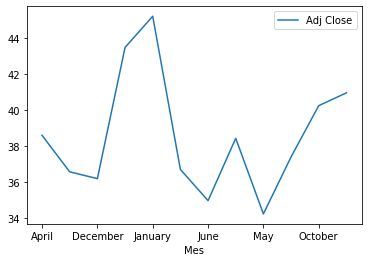

In [200]:
# gerando gráfico 

pivot_table_meses.plot();

# Faltou um 'inplace' na  hora de definir o sort_values! do gráfico acima

In [201]:
# se fizer esse processo mais de uma vez irá dar erro

pivot_table_meses.sort_values(by = 'months', inplace = True)
pivot_table_meses.index = pivot_table_meses.months


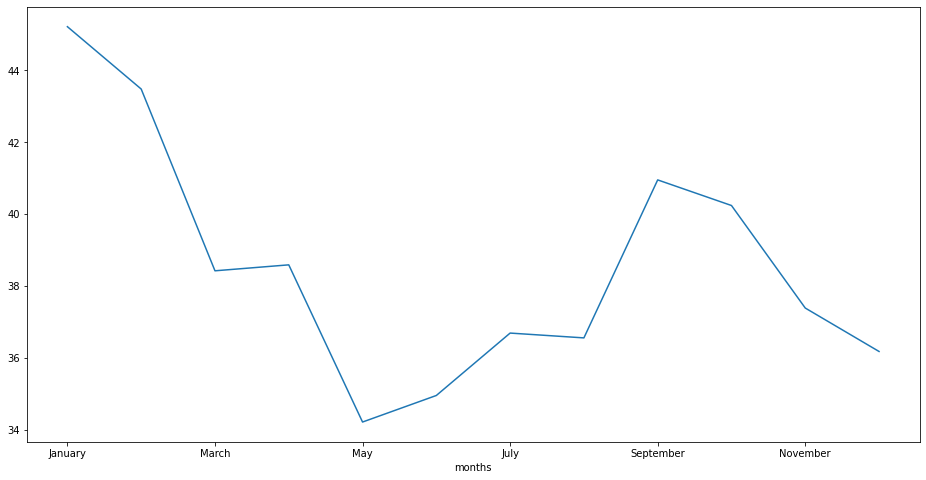

In [202]:
# amplianto o tamanho do gráfico

pivot_table_meses['Adj Close'].plot(figsize = (16,8))

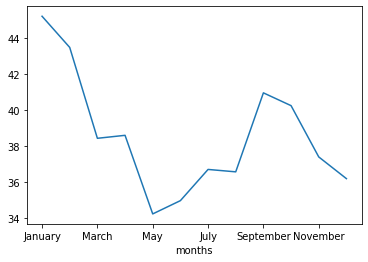

In [203]:
# novo olhar do gráfico
pivot_table_meses['Adj Close'].plot()

Fazer os dois papeis faltantes

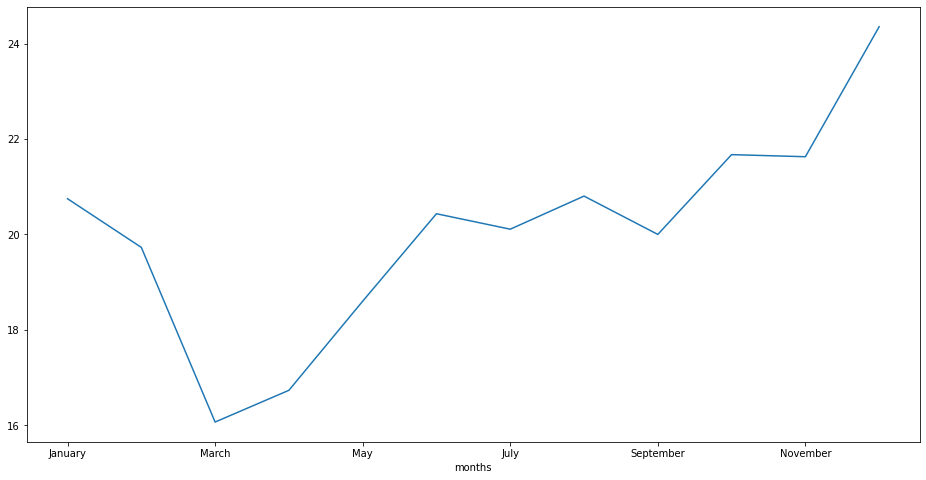

In [204]:
# Para as ações de PETR4

acao ="PETR4"
dados_acao = IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']==acao]
# não precisamos mais do comando head
# dados_acao.head()

pivot_table_meses = pd.pivot_table(dados_acao, values = 'Adj Close',
            index = ['Mes'], columns = [], aggfunc = np.max)

pivot_table_meses.sort_values('Adj Close', ascending = True) 


months = ['January',"February",'March','April','May','June',
          'July','August','September','October','November','December']
pivot_table_meses['months'] = pd.Categorical(pivot_table_meses.index, categories=months, ordered = True)

pivot_table_meses.sort_values(by = 'months', inplace = True)
pivot_table_meses.index = pivot_table_meses.months

pivot_table_meses['Adj Close'].plot(figsize = (16,8))

# 3.6 Group by
## Módulo 03 Aula 5

Método para agrupar um dataframe usando como base uma ou mais variáveis.
Esta operação envolve a seleção de uma ou mais variáveis como referência para o agrupamento e uma função de consolicação para calcular o resultado

In [205]:
IBOV_shares_ohlc.head()

,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,Adj Close,Volume,Result_bin,Resultado_oc
Date,,,,,,,,,,,,
2021-01-04,2021,January,Monday,ABCB4,15.794977,16.212465,15.715455,16.103123,14.575881,1579948.0,Positivo,0.308146
2021-01-05,2021,January,Tuesday,ABCB4,16.142883,16.142883,15.635934,15.874499,14.368940,1177843.0,Negativo,-0.268384
2021-01-06,2021,January,Wednesday,ABCB4,15.904319,16.301928,15.854618,16.053423,14.530895,996056.0,Positivo,0.149104
2021-01-07,2021,January,Thursday,ABCB4,15.860000,16.250000,15.800000,16.240000,15.016090,1018500.0,Positivo,0.380000
2021-01-08,2021,January,Friday,ABCB4,16.270000,16.490000,15.970000,16.219999,14.997596,1407000.0,Negativo,-0.050001


In [206]:
# agrupando 'Ativo' com a média (.mean)
# Resultado médio agrupado por ativo

IBOV_shares_ohlc.groupby(['Ativo']).mean()

,Open,High,Low,Close,Adj Close,Volume,Resultado_oc
Ativo,,,,,,,
ABCB4,15.794624,16.045616,15.530389,15.777049,14.910691,8.743544e+05,-0.017575
BBAS3,31.481538,31.885466,31.026073,31.395830,29.167549,1.595578e+07,-0.085708
BBDC4,20.937758,21.226044,20.619667,20.902660,20.189409,4.795344e+07,-0.035099
BPAN4,16.010648,16.485992,15.524008,15.975587,15.588426,6.503081e+06,-0.035061
CGAS3,152.083361,152.533806,151.835587,152.229150,141.958377,1.412955e+02,0.145789
CMIG4,9.777928,9.919562,9.634317,9.770047,8.409827,1.271012e+07,-0.007881
CSNA3,36.245142,36.951538,35.423522,36.126802,34.475704,1.349535e+07,-0.118340
CYRE3,21.677125,22.077530,21.199109,21.608583,20.467660,6.972036e+06,-0.068542
ELET3,37.001215,37.620041,36.249555,36.924494,35.853506,6.330271e+06,-0.076721


 Calculando as variações percentuais que os papéis tiveram nos pregões

In [207]:
# Fazendo que o Resultado_oc vire uma coluna

IBOV_shares_ohlc['Resultado_oc']= (IBOV_shares_ohlc['Close'] - IBOV_shares_ohlc['Open'])/(IBOV_shares_ohlc['Open'])

In [208]:
# incluindo na análise o mes
# Valores médios de Open, High, Low, Close, Adj Close, Volume e resultado diário para os papéis, por mês
IBOV_shares_ohlc.groupby(['Ativo', 'Mes']).mean()

Open        High         Low       Close   Adj Close  \
Ativo Mes                                                                     
ABCB4 April      14.539500   14.722000   14.399500   14.519500   13.625406    
      August     15.300455   15.611818   15.111364   15.371818   14.626959    
      December   16.853333   17.086190   16.508572   16.769048   16.202982    
      February   15.622222   15.898889   15.354444   15.566111   14.392987    
      January    15.872220   16.138278   15.612421   15.835844   14.593155    
      July       15.178095   15.334286   14.964286   15.140000   14.406374    
      June       17.342857   17.470952   17.047143   17.250953   16.188659    
      March      15.134348   15.359565   14.818261   15.100870   13.962809    
      May        15.779048   16.081905   15.579524   15.868571   14.891404    
      November   16.173000   16.513000   15.872000   16.231000   15.683097    
      October    15.818500   16.115500   15.467500   15.841000   15.260693    
      September  15.950476   16.251429   15.659524   15.853810   15.085594    
BBAS3 April      29.835500   30.111000   29.494500   29.712500   27.197846    
      August     30.576818   30.945455   30.175455   30.445909   28.448524    
      December   31.243333   31.526666   30.721905   30.943333   29.835632    
      February   32.893333   33.254445   32.311111   32.600555   29.338281    
      January    36.675263   37.167369   35.865790   36.354211   32.615425    
      July       32.079048   32.432857   31.772381   32.101429   29.899747    
      June       34.760476   35.080952   34.230477   34.627619   32.192661    
      March      29.699565   30.330435   29.249565   29.820000   27.245193    
      May        31.428095   31.807619   31.136190   31.537143   28.977987    
      November   29.791500   30.358000   29.403000   29.885500   28.460281    
      October    30.155500   30.606000   29.664500   30.149500   28.590017    
      September  29.327143   29.678095   28.927143   29.200476   27.624099    
BBDC4 April      21.407397   21.676115   21.108677   21.318223   20.349684    
      August     21.228099   21.453719   20.966941   21.173140   20.701960    
      December   18.274891   18.472294   17.962770   18.159740   17.890411    
      February   20.638659   20.902662   20.300275   20.495868   19.506422    
      January    21.807307   22.162679   21.392779   21.721183   20.650431    
      July       22.471428   22.703462   22.189610   22.483982   21.921486    
      June       25.024242   25.322077   24.709090   24.993506   23.894333    
      March      20.795184   21.273086   20.506647   20.964067   19.980068    
      May        22.738528   23.028138   22.486147   22.867099   21.846057    
      November   18.550000   18.864090   18.191818   18.484091   18.120215    
      October    18.974090   19.264545   18.628636   18.925908   18.536259    
      September  19.198268   19.432900   18.827705   19.056709   18.647826    
BPAN4 April      14.670000   15.353000   14.283000   14.904500   14.533884    
      August     19.722273   20.231818   19.091818   19.600909   19.121079    
      December   11.319048   11.746191   10.875714   11.216190   11.006361    
      February   12.368889   12.911111   12.088333   12.602778   12.289396    
      January    9.505789    9.706316    9.337368    9.500526    9.264286     
      July       22.926190   23.390000   22.315238   22.734286   22.177751    
      June       24.026667   24.638095   23.422857   24.021429   23.433384    
      March      11.880435   12.174348   11.420435   11.744783   11.452736    
      May        19.631905   20.249524   19.121905   19.774762   19.289991    
      November   12.302000   12.756000   11.835500   12.198500   11.899881    
      October    15.432500   15.956000   14.779000   15.296500   14.922042    
      September  17.150952   17.538571   16.587619   16.980476   16.564794    
CGAS3 April      151.321498  151.864498  151.081998  151.624998  140.9586

In [209]:
# Filtrando para um Ativo específico. Ex. 'WEGE3'

IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo'] == 'WEGE3'].groupby(['Ativo','Mes']).mean()

Open       High        Low      Close  Adj Close  \
Ativo Mes                                                                
WEGE3 April      37.754250  38.228750  37.139750  37.492000  36.952398   
      August     35.836364  36.276364  35.164545  35.839546  35.502604   
      December   34.279048  34.783810  33.733333  34.195238  33.902322   
      February   42.580556  43.214722  41.654722  42.233889  41.420449   
      January    43.264474  44.366842  42.458947  43.407895  42.571843   
      July       34.969047  35.523334  34.523333  35.042857  34.559645   
      June       34.368572  34.811905  33.848571  34.330953  33.839787   
      March      36.491087  37.063696  35.742826  36.453261  35.914112   
      May        32.869524  33.324762  32.406667  32.823810  32.351394   
      November   35.677500  36.048500  35.038500  35.435500  35.119947   
      October    39.156500  39.764000  38.357500  39.071500  38.723569   
      September  38.784762  39.474286  38.232857  38.981429  38.618755   

                       Volume  Resultado_oc  
Ativo Mes                                    
WEGE3 April      1.050300e+07 -0.006962      
      August     8.102223e+06  0.000388      
      December   6.761619e+06 -0.002271      
      February   1.285247e+07 -0.008009      
      January    1.275969e+07  0.004228      
      July       7.280795e+06  0.002264      
      June       7.789248e+06 -0.000974      
      March      1.337234e+07 -0.000711      
      May        8.619419e+06 -0.001179      
      November   6.647980e+06 -0.006844      
      October    7.668745e+06 -0.002084      
      September  9.171210e+06  0.005370

In [210]:
# Ordenando o resultado acima

IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo'] == 'WEGE3'].groupby(['Ativo','Mes']).mean().sort_values(by = 'Resultado_oc')

Open       High        Low      Close  Adj Close  \
Ativo Mes                                                                
WEGE3 February   42.580556  43.214722  41.654722  42.233889  41.420449   
      April      37.754250  38.228750  37.139750  37.492000  36.952398   
      November   35.677500  36.048500  35.038500  35.435500  35.119947   
      December   34.279048  34.783810  33.733333  34.195238  33.902322   
      October    39.156500  39.764000  38.357500  39.071500  38.723569   
      May        32.869524  33.324762  32.406667  32.823810  32.351394   
      June       34.368572  34.811905  33.848571  34.330953  33.839787   
      March      36.491087  37.063696  35.742826  36.453261  35.914112   
      August     35.836364  36.276364  35.164545  35.839546  35.502604   
      July       34.969047  35.523334  34.523333  35.042857  34.559645   
      January    43.264474  44.366842  42.458947  43.407895  42.571843   
      September  38.784762  39.474286  38.232857  38.981429  38.618755   

                       Volume  Resultado_oc  
Ativo Mes                                    
WEGE3 February   1.285247e+07 -0.008009      
      April      1.050300e+07 -0.006962      
      November   6.647980e+06 -0.006844      
      December   6.761619e+06 -0.002271      
      October    7.668745e+06 -0.002084      
      May        8.619419e+06 -0.001179      
      June       7.789248e+06 -0.000974      
      March      1.337234e+07 -0.000711      
      August     8.102223e+06  0.000388      
      July       7.280795e+06  0.002264      
      January    1.275969e+07  0.004228      
      September  9.171210e+06  0.005370

Observe que de acordo com a tabela acima, os melhores meses para WEGE3 são julho, janeiro e setembro.

E com relação a dias da semana ?

In [211]:
IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']== 'WEGE3'].groupby(['Ativo', 'Dia_semana']).mean().sort_values(by = 'Resultado_oc')

Open       High        Low      Close  Adj Close  \
Ativo Dia_semana                                                          
WEGE3 Thursday    37.236078  37.787745  36.573235  37.079902  36.599605   
      Monday      36.815817  37.322245  36.213979  36.711225  36.242848   
      Friday      37.193958  37.748021  36.561458  37.149687  36.662391   
      Wednesday   37.118039  37.749412  36.413431  37.124706  36.643108   
      Tuesday     36.818333  37.404063  36.225208  36.838021  36.355636   

                        Volume  Resultado_oc  
Ativo Dia_semana                              
WEGE3 Thursday    9.595337e+06 -0.003550      
      Monday      8.065173e+06 -0.002945      
      Friday      9.001131e+06 -0.000830      
      Wednesday   1.022324e+07  0.000078      
      Tuesday     9.376219e+06  0.000816

Qual foi o volume total negociado de WEGE3 ao longo dos anos e meses?

In [212]:
# ordenando pelo resultado

IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']== 'WEGE3'].groupby(['Ano', 'Mes']).sum().sort_values(by = 'Resultado_oc')

Open        High         Low       Close   Adj Close  \
Ano  Mes                                                                     
2021 February   766.450005  777.865002  749.785000  760.209999  745.568089   
     April      755.084995  764.574993  742.795002  749.840008  739.047966   
     November   713.549995  720.970005  700.769991  708.709995  702.398949   
     December   719.860001  730.460003  708.399994  718.099995  711.948761   
     October    783.129997  795.280006  767.149998  781.429993  774.471375   
     May        690.260010  699.820000  680.539997  689.300005  679.379274   
     June       721.740009  731.050003  710.819996  720.950005  710.635529   
     March      839.294994  852.465004  822.084991  838.424999  826.024574   
     August     788.400009  798.079998  773.619999  788.470005  781.057297   
     July       734.349995  745.990013  724.989990  735.899998  725.752537   
     January    822.025002  842.970001  806.719997  824.750004  808.865013   
     September  814.480003  828.960011  802.889996  818.610004  810.993862   

                     Volume  Resultado_oc  
Ano  Mes                                   
2021 February   231344400.0 -0.144160      
     April      210059900.0 -0.139235      
     November   132959600.0 -0.136883      
     December   141994000.0 -0.047699      
     October    153374900.0 -0.041685      
     May        181007800.0 -0.024764      
     June       163574200.0 -0.020461      
     March      307563800.0 -0.016358      
     August     178248900.0  0.008534      
     July       152896700.0  0.047534      
     January    242434200.0  0.080324      
     September  192595400.0  0.112777

In [213]:
# ordenando pelo volume

IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']== 'WEGE3'].groupby(['Ano', 'Mes']).sum().sort_values(by = 'Volume')

Open        High         Low       Close   Adj Close  \
Ano  Mes                                                                     
2021 November   713.549995  720.970005  700.769991  708.709995  702.398949   
     December   719.860001  730.460003  708.399994  718.099995  711.948761   
     July       734.349995  745.990013  724.989990  735.899998  725.752537   
     October    783.129997  795.280006  767.149998  781.429993  774.471375   
     June       721.740009  731.050003  710.819996  720.950005  710.635529   
     August     788.400009  798.079998  773.619999  788.470005  781.057297   
     May        690.260010  699.820000  680.539997  689.300005  679.379274   
     September  814.480003  828.960011  802.889996  818.610004  810.993862   
     April      755.084995  764.574993  742.795002  749.840008  739.047966   
     February   766.450005  777.865002  749.785000  760.209999  745.568089   
     January    822.025002  842.970001  806.719997  824.750004  808.865013   
     March      839.294994  852.465004  822.084991  838.424999  826.024574   

                     Volume  Resultado_oc  
Ano  Mes                                   
2021 November   132959600.0 -0.136883      
     December   141994000.0 -0.047699      
     July       152896700.0  0.047534      
     October    153374900.0 -0.041685      
     June       163574200.0 -0.020461      
     August     178248900.0  0.008534      
     May        181007800.0 -0.024764      
     September  192595400.0  0.112777      
     April      210059900.0 -0.139235      
     February   231344400.0 -0.144160      
     January    242434200.0  0.080324      
     March      307563800.0 -0.016358

Houve uma tendência de redução do volume negociado de WEGE3 ao longo do ano!

Qual dos papéis foi mais negociado?

In [214]:
# tira o filtro  [IBOV_shares_ohlc['Ativo']== 'WEGE3']
IBOV_shares_ohlc.groupby(['Ativo']).sum().sort_values(by = 'Volume')

,Open,High,Low,Close,Adj Close,Volume,Resultado_oc
Ativo,,,,,,,
CGAS3,37564.590057,37675.850067,37503.390045,37600.600052,35063.719177,3.490000e+04,0.264004
ABCB4,3901.272181,3963.267267,3836.006004,3896.931050,3682.940612,2.159655e+08,-0.216404
TUPY3,5447.629997,5543.249989,5348.080002,5439.880009,5343.618601,2.740377e+08,-0.293584
MYPK3,3759.050007,3836.619995,3686.569990,3757.179999,3406.399273,4.385483e+08,-0.037185
EZTC3,7128.160009,7250.130001,6972.810019,7099.629999,6812.657316,6.259201e+08,-0.843597
RAPT4,3229.750000,3282.209998,3163.780006,3217.599997,3025.397715,7.734114e+08,-0.848323
ENBR3,4699.889994,4751.819998,4650.620003,4696.629995,4211.753135,7.853197e+08,-0.156458
SBSP3,9491.719999,9639.590000,9348.949989,9489.420015,9266.849628,8.162068e+08,0.012244
MRVE3,3811.550010,3878.630009,3740.279995,3801.149999,3728.790427,1.145728e+09,-0.623799


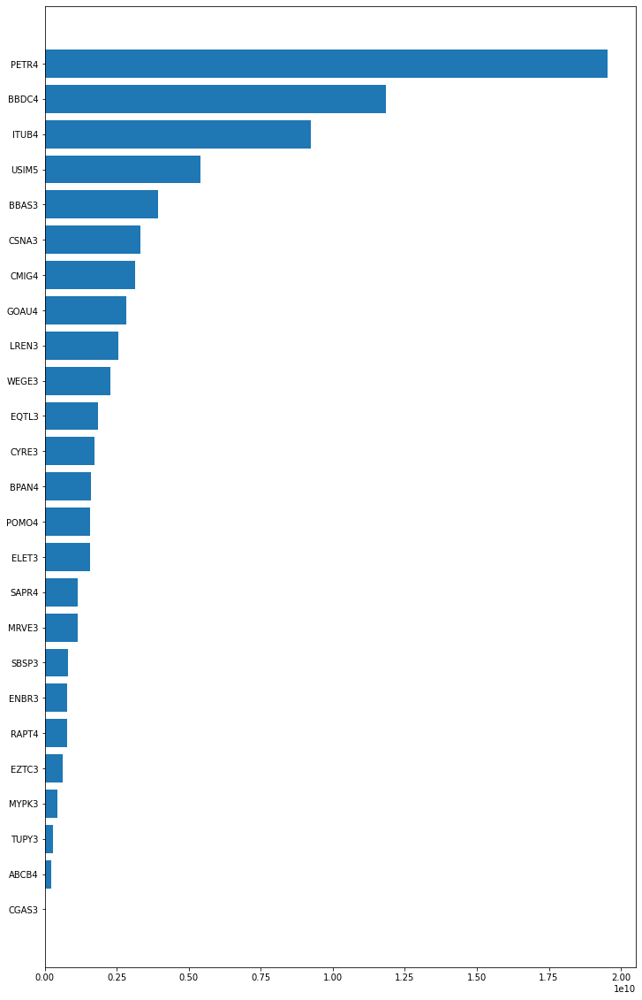

In [215]:
# Transformando em dataframe para visualização 

volume = IBOV_shares_ohlc.groupby(['Ativo']).sum().sort_values(by = 'Volume')

import matplotlib.pyplot as plt

y = volume.index

x = volume.Volume

# Inicializar a figura e os eixos
fig, ax = plt.subplots()

# fig size 

fig.set_size_inches(12, 20)

# Criar as barras horizontais
ax.barh(y = y, width = x);

# 3.7 Join ( ou merge)

Operação realizada para unir dois dataframes diferentes.

Estes dataframes podem ou não conter dados para os mesmos indivíduos, observações ou datas, por isso é necessário especificar qual plt.tripcolor de join vamos aplicar

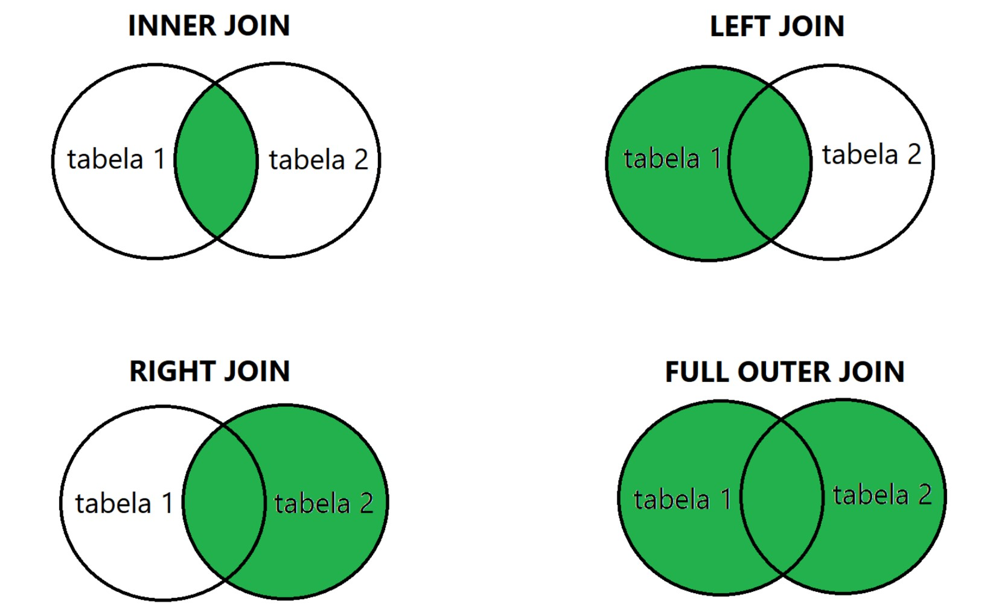

In [216]:
from IPython.display import Image
Image(filename = '/content/Tipos_de_join.jpg', width = 750, height = 450 )

# 3.7.1 Abrindo uma nova tabela 

In [217]:
import pandas as pd
import yfinance as yf

In [218]:
ibov = pd.read_csv('/content/Bovespa.csv')

In [219]:
ibov.head()

,Date,ABCB4,BBAS3,BBDC4,BPAN4,BTOW3,CGAS3,CMIG4,CSNA3,CYRE3,ELET3,ELPL4,ENBR3,EQTL3,EZTC3,FIBR3,GOAU4,HGTX3,ITUB4,LAME4,LREN3,MRVE3,MYPK3,PETR4,POMO4,QGEP3,RAPT4,SAPR4,SBSP3,SUZB5,TUPY3,USIM5,VALE5,WEGE3
0,6/5/2012,5.778904,13.193346,14.825962,NaN,4.67417,21.089613,16.403233,9.799454,13.011072,11.257472,20.374283,9.643664,13.965112,13.307925,11.179023,19.067270,31.916170,16.424917,7.465813,6.680956,6.422756,20.142883,17.360838,3.559332,7.938090,6.136378,4.945431,19.482090,4.228104,18.623053,7.724799,28.628716,6.314218
1,6/6/2012,5.784656,13.474055,15.421063,NaN,4.95184,21.367132,17.082111,9.838496,13.979592,11.669867,20.792694,9.666734,13.781371,13.768991,11.241525,19.912804,33.010902,17.112257,7.593978,6.824133,6.691389,22.102579,17.628639,3.727821,8.013066,6.316431,4.918369,19.842842,4.291890,18.852964,7.456715,29.472841,6.454251
2,6/8/2012,5.836405,13.488092,15.457347,NaN,5.08142,22.088638,17.082111,9.799454,14.025277,12.020839,21.151339,9.912613,13.312838,13.901682,11.509394,19.855799,33.968792,17.011543,7.549116,6.851561,6.951880,22.102579,17.434713,3.694127,7.825626,6.338035,5.256635,19.926100,4.437686,18.535686,7.635437,29.727674,6.368317
3,6/11/2012,5.922663,13.614412,15.628112,NaN,5.09993,22.088638,17.120369,9.705755,13.723758,11.827804,21.048868,9.781995,13.505715,14.111280,11.045089,19.751295,33.598526,17.183395,7.593978,6.871836,6.813494,22.827446,16.982224,3.753094,7.413257,6.482082,5.195747,20.203676,4.237216,17.629826,7.883664,29.377279,6.368317
4,6/12/2012,5.876658,13.614412,15.886813,NaN,5.34984,22.088638,17.689350,9.736986,13.632388,12.178778,21.680763,9.951033,13.873288,14.181119,11.429033,20.435322,34.612743,17.479654,7.843906,7.053199,6.756513,22.594780,17.176149,3.799433,7.413257,6.482082,5.202512,20.739265,4.146093,17.933311,7.754586,30.038250,6.365140


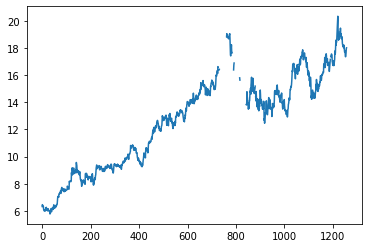

In [220]:
ibov.WEGE3.plot()

Vamos extrair dados de outras fontes

In [221]:
lren = yf.download('LREN3.SA', start = '2017-01-01', end = '2017-07-20')

[*********************100%***********************]  1 of 1 completed


In [222]:
lren.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2017-01-02,18.775900,19.013674,18.702108,18.972677,17.484583,676417
2017-01-03,19.103865,19.677799,18.808697,19.554813,18.021057,2976064
2017-01-04,19.636805,19.833582,19.177654,19.382631,17.862381,2671030
2017-01-05,19.464622,19.587610,19.161257,19.202253,17.696156,3587596
2017-01-06,19.202253,19.202253,18.808697,18.980877,17.492140,2139141


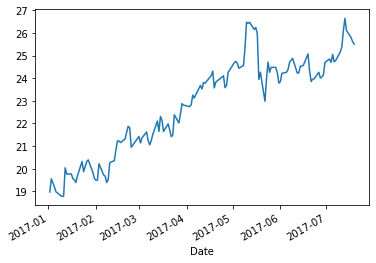

In [223]:
lren.Close.plot()

In [224]:
# Modificar os nomes das colunas de adjusted closed
           # coluna que quero mudar o nome : para novo nome
lren.rename(columns = {'Adj Close': "LREN3"}, inplace = True)

In [225]:
lren.head()

,Open,High,Low,Close,LREN3,Volume
Date,,,,,,
2017-01-02,18.775900,19.013674,18.702108,18.972677,17.484583,676417
2017-01-03,19.103865,19.677799,18.808697,19.554813,18.021057,2976064
2017-01-04,19.636805,19.833582,19.177654,19.382631,17.862381,2671030
2017-01-05,19.464622,19.587610,19.161257,19.202253,17.696156,3587596
2017-01-06,19.202253,19.202253,18.808697,18.980877,17.492140,2139141


Filtrando coluna específica no dataframe de IBOV 

In [226]:
acao = 'BBAS3'
# passando indice para date(str) para Date(data)
ibov.index = pd.to_datetime(ibov.Date)
BBAS = ibov[acao]

In [227]:
BBAS.head()

Date
2012-06-05    13.193346
2012-06-06    13.474055
2012-06-08    13.488092
2012-06-11    13.614412
2012-06-12    13.614412
Name: BBAS3, dtype: float64

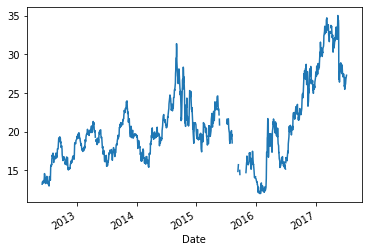

In [228]:
BBAS.plot()

In [229]:
# unir as duas tabelas
# trazendo apenas as datas em comum entre ambas

novo = pd.merge(BBAS, lren, how = 'inner', on = 'Date')

In [230]:
novo.head()

,BBAS3,Open,High,Low,Close,LREN3,Volume
Date,,,,,,,
2017-01-02,27.193352,18.775900,19.013674,18.702108,18.972677,17.484583,676417
2017-01-03,28.437492,19.103865,19.677799,18.808697,19.554813,18.021057,2976064
2017-01-04,28.289377,19.636805,19.833582,19.177654,19.382631,17.862381,2671030
2017-01-05,28.220261,19.464622,19.587610,19.161257,19.202253,17.696156,3587596
2017-01-06,28.526356,19.202253,19.202253,18.808697,18.980877,17.492140,2139141


In [231]:
# Filtrando apenas duas colunas

cotacoes = novo[['BBAS3','LREN3']]

In [232]:
cotacoes.head()

,BBAS3,LREN3
Date,,
2017-01-02,27.193352,17.484583
2017-01-03,28.437492,18.021057
2017-01-04,28.289377,17.862381
2017-01-05,28.220261,17.696156
2017-01-06,28.526356,17.492140


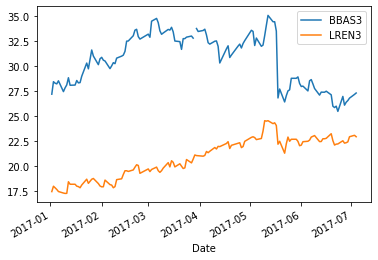

In [233]:
# por ser join tipo inner traz somente os dados que são comuns nas duas 

cotacoes.plot()

In [234]:
# Filtro pelo ativo PETR4

petro = IBOV_shares_ohlc[IBOV_shares_ohlc['Ativo']=='PETR4']
# renomeando a coluna Adj Close por PETR4
petro.rename(columns = {'Adj Close':'PETR4'}, inplace = True)
petro.head()

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Ano,Mes,Dia_semana,Ativo,Open,High,Low,Close,PETR4,Volume,Result_bin,Resultado_oc
Date,,,,,,,,,,,,
2021-01-04,2021,January,Monday,PETR4,28.650000,29.18,28.530001,28.910000,19.274342,74719700.0,Positivo,0.009075
2021-01-05,2021,January,Tuesday,PETR4,28.900000,30.18,28.240000,30.040001,20.027716,95181100.0,Positivo,0.039446
2021-01-06,2021,January,Wednesday,PETR4,30.160000,30.90,30.049999,30.100000,20.067717,96562500.0,Negativo,-0.001989
2021-01-07,2021,January,Thursday,PETR4,30.340000,31.15,30.340000,31.000000,20.667747,56171300.0,Positivo,0.021753
2021-01-08,2021,January,Friday,PETR4,31.459999,31.76,30.350000,31.120001,20.747753,67136300.0,Negativo,-0.010807


In [235]:
# verificando as colunas

petro.columns

Index(['Ano', 'Mes', 'Dia_semana', 'Ativo', 'Open', 'High', 'Low', 'Close',
       'PETR4', 'Volume', 'Result_bin', 'Resultado_oc'],
      dtype='object')

In [236]:
# unindo o ( novo) com petr

final = pd.merge(novo, petro, how = 'inner', on = 'Date')

In [237]:
final.head()

,BBAS3,Open_x,High_x,Low_x,Close_x,LREN3,Volume_x,Ano,Mes,Dia_semana,Ativo,Open_y,High_y,Low_y,Close_y,PETR4,Volume_y,Result_bin,Resultado_oc
Date,,,,,,,,,,,,,,,,,,,


In [238]:
final.shape

(0, 19)

Por que o join não retornou nenhuma linha? Porque não há interseção dos dados!

In [239]:
final = pd.merge(novo, petro, how = 'outer', on = 'Date')

In [240]:
final.shape

(373, 19)

In [241]:
final.head()

,BBAS3,Open_x,High_x,Low_x,Close_x,LREN3,Volume_x,Ano,Mes,Dia_semana,Ativo,Open_y,High_y,Low_y,Close_y,PETR4,Volume_y,Result_bin,Resultado_oc
Date,,,,,,,,,,,,,,,,,,,
2017-01-02,27.193352,18.775900,19.013674,18.702108,18.972677,17.484583,676417.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-03,28.437492,19.103865,19.677799,18.808697,19.554813,18.021057,2976064.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-04,28.289377,19.636805,19.833582,19.177654,19.382631,17.862381,2671030.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-05,28.220261,19.464622,19.587610,19.161257,19.202253,17.696156,3587596.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-06,28.526356,19.202253,19.202253,18.808697,18.980877,17.492140,2139141.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


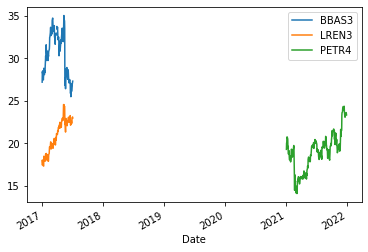

In [242]:
# Fazendo o filtra para usar apenas as colunas a ser analizadas

final[['BBAS3','LREN3','PETR4']].plot()

### Perceba então o resultado: temos dados para períodos diferentes em cada um dos papéis!
É exatamente por isso que o gráfico resultante acima ficou com um 'vazio'.

Vamos fazer alguns exemplos com left e right join?

Antes disso, vamos verificar a documentação da função merge da biblioteca pandas:
https://pandas.pydata.org/docs/reference/api/pandas.Dataframe.merge.html

In [247]:
weg = yf.download('WEGE3.SA', start = '2017-01-01', end = '2022-05-01' )

weg.rename(columns = {'Adj Close': 'WEGE3'}, inplace=True)

[*********************100%***********************]  1 of 1 completed


In [248]:
weg.head()

,Open,High,Low,Close,WEGE3,Volume
Date,,,,,,
2017-01-02,5.923076,5.926923,5.734615,5.807692,5.363054,2133040
2017-01-03,5.861538,6.130769,5.842307,6.100000,5.632983,5048160
2017-01-04,6.107692,6.126923,5.915384,5.953846,5.498019,5267860
2017-01-05,5.965384,6.034615,5.876923,5.938461,5.483811,4526340
2017-01-06,5.980769,6.050000,5.907692,5.988461,5.529984,3394560


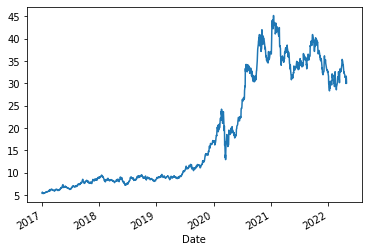

In [249]:
weg['WEGE3'].plot();

Vamos iniciar realizando um left join, sendo que neste caso o 'left' ou seja, o dataframe da esquerda será o dataframe final criado acima, e o  'right', ou seja, dataframe da direita, será o novo dataframe de weg.

In [250]:
final_left1 = pd.merge(final, weg, how = 'left', on ='Date')

In [251]:
final_left1.head()

,BBAS3,Open_x,High_x,Low_x,Close_x,LREN3,Volume_x,Ano,Mes,Dia_semana,Ativo,Open_y,High_y,Low_y,Close_y,PETR4,Volume_y,Result_bin,Resultado_oc,Open,High,Low,Close,WEGE3,Volume
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-02,27.193352,18.775900,19.013674,18.702108,18.972677,17.484583,676417.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.923076,5.926923,5.734615,5.807692,5.363054,2133040
2017-01-03,28.437492,19.103865,19.677799,18.808697,19.554813,18.021057,2976064.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.861538,6.130769,5.842307,6.100000,5.632983,5048160
2017-01-04,28.289377,19.636805,19.833582,19.177654,19.382631,17.862381,2671030.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.107692,6.126923,5.915384,5.953846,5.498019,5267860
2017-01-05,28.220261,19.464622,19.587610,19.161257,19.202253,17.696156,3587596.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.965384,6.034615,5.876923,5.938461,5.483811,4526340
2017-01-06,28.526356,19.202253,19.202253,18.808697,18.980877,17.492140,2139141.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.980769,6.050000,5.907692,5.988461,5.529984,3394560


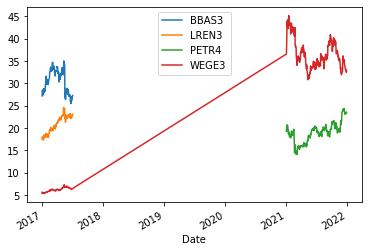

In [252]:
final_left1[['BBAS3', 'LREN3', 'PETR4','WEGE3']].plot()

Você consegue encontrar a razão por isso ter acontecido?
Basicamente, o 'left join' determina que a tabela da esquerda tem a prioridade sobre a tabela da direita.
Ou seja,, a operação trará todos os dados presentes na tabela da esquerda.


**No entanto, para a tabela da direita, a operação retornará apenas a seção destes dados que tem interseção com a tabela da esquerda.**


No caso acima,WEGE3 tem dados disponíveis para todo o período de tempo, mas possui interseção com o dataframe da esquerda apenas
nos períodos de 2017 e 2021.

Uma forma de resolvermos isso é mudar a ordem de prioridade das tabelas, fazendo um **right join** ao invé de left join, pois isso dará
prioridade aos dados de WEGE3. Desta forma, a operação trará todos os dados da tabela de WEGE3 e apenas os dados que tiverem interseção
na tabela final.

In [253]:
final_right1 = pd.merge(final, weg, how = 'right', on = 'Date')

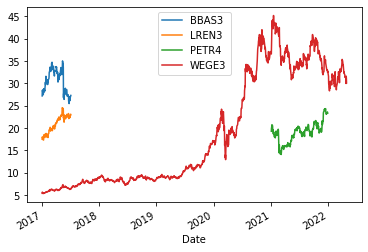

In [254]:
final_right1[['BBAS3','LREN3', 'PETR4', 'WEGE3']].plot()

E se invertessemos completamente a ordem dos dataframes?

Vamos fazer os mesmos right e left j join, só que desta vez invertendo a ordem dos dataframes

In [255]:
final_left2 = pd.merge(weg, final, how = 'left', on ='Date')

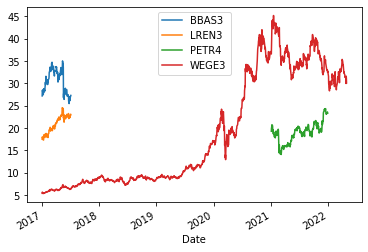

In [256]:
final_left2[['BBAS3','LREN3', 'PETR4', 'WEGE3']].plot()

In [257]:
final_right2 = pd.merge(weg, final, how = 'right', on = 'Date')

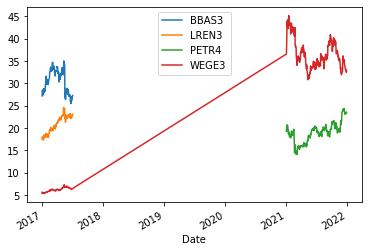

In [258]:
final_right2[['BBAS3','LREN3', 'PETR4', 'WEGE3']].plot()

E se fizessemos um outer join com esses dados?

In [259]:
final_outer = pd.merge(final, weg, how = 'outer', on = 'Date')

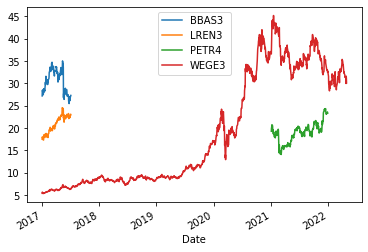

In [260]:
final_outer[['BBAS3','LREN3', 'PETR4', 'WEGE3']].plot()